In [376]:
from tifffile import imread
import matplotlib.pyplot as plt
import numpy as np
plt.rcParams.update({'font.size': 24})


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Reading img...
Loading /home/miguel/Projects/uni/data/smlm_3d/bead_3D_STORM_three_instruments/20200723_OpenFrame_3D_beads/glass_beads_agarose_1/glass_beads_agarose_1_MMStack_Default.ome.tif
Loading /home/miguel/Projects/uni/data/smlm_3d/bead_3D_STORM_three_instruments/20200723_OpenFrame_3D_beads/glass_beads_agarose_1/glass_beads_agarose_1_MMStack_Default_filtered.csv


reversing stack!!


87 emitters before filtering
87 emitters after proximity filtering.
87 emitters after borders
sub psf (32, 384)


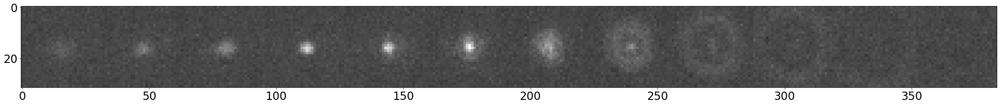

In [377]:
%load_ext autoreload
%autoreload 2
from final_project.smlm_3d.data import datasets
from final_project.smlm_3d.config.datasets import dataset_configs
from final_project.smlm_3d.data.estimate_offset import estimate_offset as base_offset_est
from final_project.smlm_3d.data.visualise import show_psf_axial 

# baseline values: 45.6 25.8
from scipy.ndimage import gaussian_filter

from skimage.filters import butterworth
from skimage.restoration import denoise_tv_chambolle

dataset = 'openframe'

cfg = dataset_configs[dataset]['training']
ds = datasets.TrainingDataSet(cfg, z_range=100000, transform_data=False, add_noise=False, lazy=True)

ds.prepare_debug()

psf = ds.debug_emitter(0, 5000)[0]
show_psf_axial(psf, '', 10)

False
{'bpath': PosixPath('/home/miguel/Projects/uni/data/smlm_3d/bead_3D_STORM_three_instruments/20200723_OpenFrame_3D_beads/glass_beads_agarose_1'), 'img': 'glass_beads_agarose_1_MMStack_Default.ome.tif', 'csv': 'glass_beads_agarose_1_MMStack_Default_filtered.csv', 'wl': 635, 'na': 1.4, 'voxel_sizes': (50, 85.8, 85.8), 'reverse_stack': True, 'ground_truth': 121}


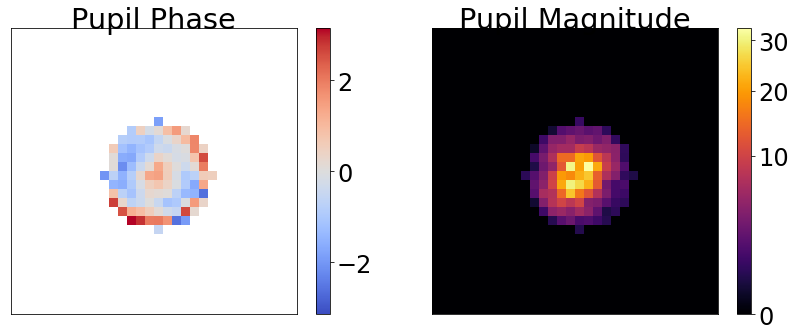

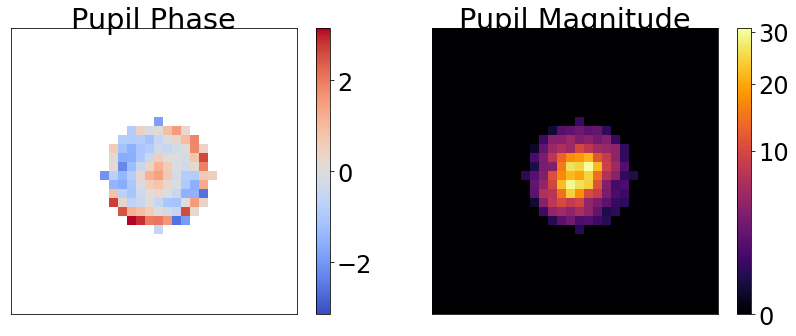

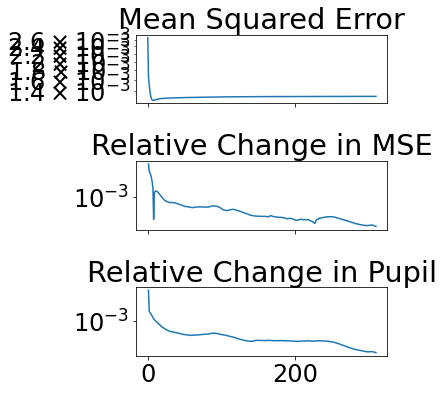

In [400]:
import pathlib

import matplotlib.pyplot as plt
import numpy as np
from pyotf.phaseretrieval import retrieve_phase
from pyotf.utils import prep_data_for_PR
from tifffile import imread
print(psf.sum() == 24680048)
print(cfg)
zsize, xsize, ysize = psf.shape
model_kwargs = dict(
    wl=cfg['wl'],
    na=cfg['na'],
    ni=1.51,
    res=cfg['voxel_sizes'][1],
    size=xsize,
    zsize=zsize,
    zres=cfg['voxel_sizes'][0],
    vec_corr="none",
    condition="none",
)

target_psf = prep_data_for_PR(psf, multiplier=1.0)
target_psf /= target_psf.max()
# Retrieve phase for experimental PSF
PR_result = retrieve_phase(target_psf, model_kwargs, max_iters=1000)

PR_result.fit_to_zernikes(120)
PR_result.plot()
PR_result.zd_result.plot()
PR_result.plot_convergence()

PR_result.zd_result.pcoefs[0] = 0
PR_result.zd_result.mcoefs[0] = 0

# Simulate HanserPSF with parameters
result_psf = PR_result.generate_zd_psf(sphase=slice(None), zsize=201)

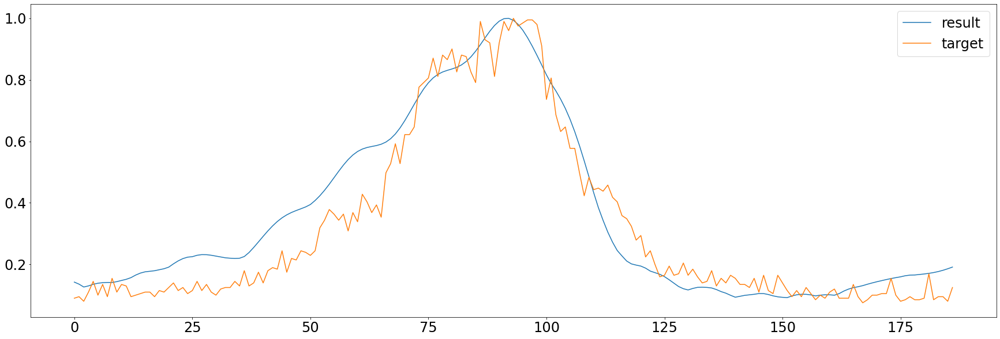

sub psf (32, 384)


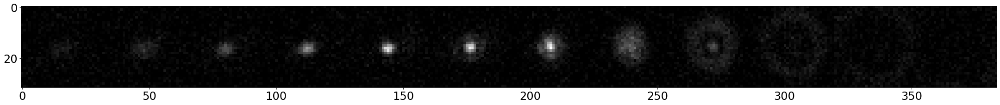

sub psf (32, 384)


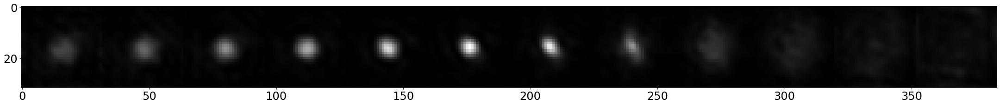

In [402]:
model_psf = target_psf
plt.plot(result_psf.max(axis=(1,2)) / result_psf.max(), label='result')
plt.plot(target_psf.max(axis=(1,2)) / target_psf.max(), label='target')
plt.legend()
plt.show()
result_psf /= result_psf.max()
target_psf /= target_psf.max()
result_psf = result_psf[0:target_psf.shape[0]]
# comb = np.concatenate((result_psf, psf), axis=2)
show_psf_axial(target_psf, '', 10)
show_psf_axial(result_psf, '', 10)



(10, 200, 40, 40)
[98, 99, 100, 101, 102]
5


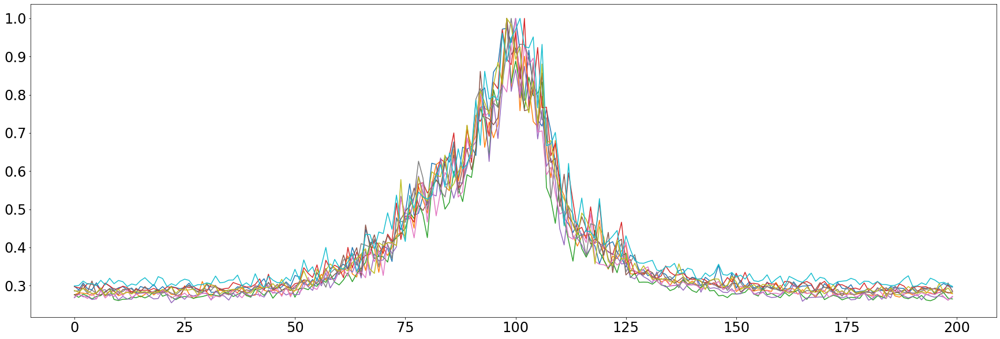

In [180]:
model_psfs = [model_psf + np.random.uniform(0, 0.3, size=model_psf.shape) for _ in range(n_psfs)]

model_psfs = np.stack([p / p.max() for p in model_psfs])
print(model_psfs.shape)

peak_vals = sorted({np.argmax(psf.max(axis=(1,2))) for psf in model_psfs})
print(peak_vals)
print(len(peak_vals))
for psf in model_psfs:
    plt.plot(psf.max(axis=(1,2)))
plt.show()

In [ ]:
def find_peak_cubic(psf, s):
    from scipy.interpolate import UnivariateSpline
    axial_max = psf.max(axis=(1,2))
    min_val = axial_max.min()
    max_val = axial_max.max()
    axial_max = (axial_max - min_val) / (max_val - min_val)

    x = np.linspace(0, psf.shape[0]-1, num=psf.shape[0])

    cs = UnivariateSpline(x, axial_max, k=3, s=s)
    sub_x = np.linspace(x.min(), x.max(), 100000, endpoint=True)
    peak = sub_x[np.argmax(cs(sub_x))]
#     show_psf_axial(psf, '', psf.shape[0]//10)
#     plt.scatter(x, axial_max)
#     plt.plot(sub_x, cs(sub_x))
#     plt.show()
    return peak

from skimage.filters import butterworth
from skimage.restoration import denoise_tv_chambolle
def butter_psf(psf, v):
    return np.stack([butterworth(img, v, False) for img in psf])

res = dict()
res['base_cubic'] = [find_peak_cubic(p, 0.2)*cfg['voxel_sizes'][0] for p in model_psfs]
res['cubic'] = [find_peak_cubic(p, 0.9)*cfg['voxel_sizes'][0] for p in model_psfs]
res['butter_cubic'] = [find_peak_cubic(butter_psf(p, 0.1), 0.9)*cfg['voxel_sizes'][0] for p in model_psfs]

# for i in range(1, 10):
#     print(i)
#     res[f'butter_cubic_{i}'] = [find_peak_cubic(butter_psf(p, i/10), 0.9)*cfg['voxel_sizes'][0] for p in model_psfs]
#     find_peak_cubic(butter_psf(model_psfs[0], i/10), 0.9)*cfg['voxel_sizes'][0]
    




for k, v in res.items():
    print(k, np.mean(v), np.mean(v)/cfg['voxel_sizes'][0], np.std(v))







In [ ]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from scipy.ndimage import center_of_mass

def remove_bg(img):
    img = img / img.max()
    bg_level = img.min()
    img = img - bg_level
    img[img<0] = 0
    img /= img.max()
    return img

psf = _psf.copy()
psf = remove_bg(psf)
X = np.array([l for l in np.ndindex(*psf.shape)])

Y = psf.ravel()


# poly = PolynomialFeatures(degree=7)
# #transform the x data for proper fitting (for single variable type it returns,[1,x,x**2])
# X_ = poly.fit_transform(X)
# predict_ = poly.fit_transform(Y)
# print(X[0])
# print(X_[0:10])
# #generate the regression object
# clf = LinearRegression()
# #preform the actual regression
# clf.fit(X_, Y)

# print("X_ = ",X_)
# print("predict_ = ",Y)

# preds = clf.predict(X_).squeeze()

from loess.loess_2d import loess_2d
x = X[:, 0]
y = X[:, 1]

preds, _ = loess_2d(x, y, Y, xnew=x, ynew=y, degree=2, frac=0.2)
print(preds.shape)
preds = preds.reshape(*psf.shape)

psf = psf / psf.max()
preds = preds / preds.max()


img = np.concatenate((psf, preds, preds2), axis=1)
plt.imshow(img)

print(center_of_mass(psf))
print(center_of_mass(preds))
print(center_of_mass(preds2))





In [356]:
%load_ext autoreload
%autoreload 2
from final_project.smlm_3d.data import datasets
from final_project.smlm_3d.config.datasets import dataset_configs
from final_project.smlm_3d.data.estimate_offset import estimate_offset as base_offset_est
from final_project.smlm_3d.data.visualise import show_psf_axial 

# baseline values: 45.6 25.8
from scipy.ndimage import gaussian_filter

from skimage.filters import butterworth
from skimage.restoration import denoise_tv_chambolle
from scipy.spatial.distance import cdist

dataset = 'openframe'

cfg = dataset_configs[dataset]['training']
ds = datasets.TrainingDataSet(cfg, z_range=100000, transform_data=False, add_noise=False, lazy=True)
ds.bound = 16
ds.prepare_debug()
n_psfs = 50

xy_coords = ds.csv_data[['x [nm]', 'y [nm]']].to_numpy()
img_dims = ds.img.shape[1:]
img_center = [i*res/2 for i, res in zip(img_dims, ds.voxel_sizes[1:])]
ds.csv_data['dist_center'] = cdist(xy_coords, [img_center])

ds.csv_data = ds.csv_data.sort_values(by='dist_center')
closest_to_center = np.argsort(ds.csv_data['dist_center'])[:n_psfs]



# ds.csv_data = ds.csv_data.iloc[closest_to_center]
ds.csv_data = ds.csv_data.iloc[0:n_psfs]




The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Reading img...
Loading /home/miguel/Projects/uni/data/smlm_3d/bead_3D_STORM_three_instruments/20200723_OpenFrame_3D_beads/glass_beads_agarose_1/glass_beads_agarose_1_MMStack_Default.ome.tif
Loading /home/miguel/Projects/uni/data/smlm_3d/bead_3D_STORM_three_instruments/20200723_OpenFrame_3D_beads/glass_beads_agarose_1/glass_beads_agarose_1_MMStack_Default_filtered.csv


reversing stack!!


87 emitters before filtering
87 emitters after proximity filtering.
87 emitters after borders


/home/miguel/Projects/uni/venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='x [nm]', ylabel='y [nm]'>

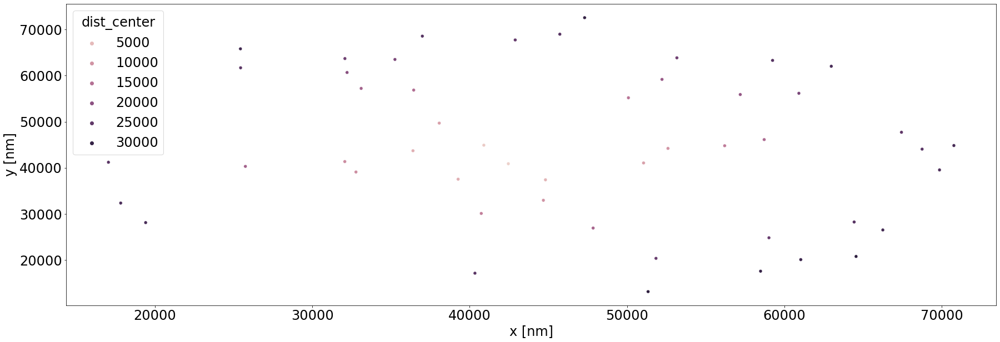

In [357]:
sns.scatterplot(ds.csv_data['x [nm]'], ds.csv_data['y [nm]'], hue=ds.csv_data['dist_center'])

sub psf (32, 384)


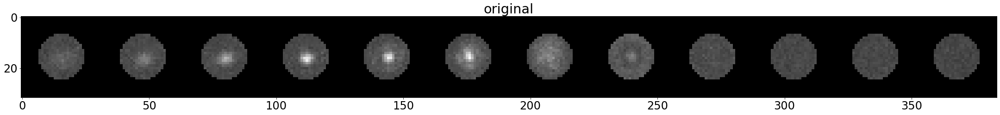

sub psf (32, 384)


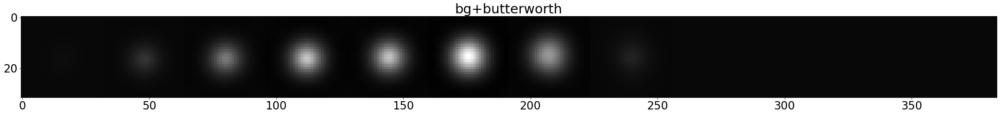

sub psf (32, 384)


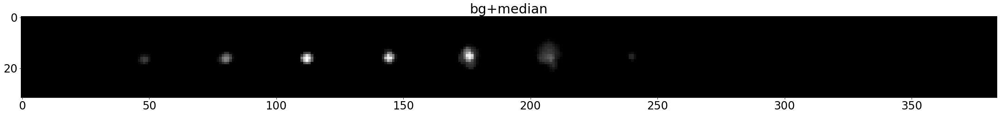

In [358]:
# PSF denoising

def create_circular_mask(h, w, center=None, radius=None):

    if center is None: # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None: # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2).astype(int)

    mask = dist_from_center <= radius
    return mask

eg_psf = ds.debug_emitter(0, 1000)[0]
mask_shape = eg_psf.shape[1:]
center = tuple(int(x/2)-0.5 for x in eg_psf.shape[1:])
radius = (eg_psf.shape[1])/4
mask = create_circular_mask(*mask_shape, center=center, radius=radius)

def mask_psf(psf):
    for i in range(psf.shape[0]):
        psf[i][~mask] = 0

def norm_zero_one(s):
    max_s = s.max()
    min_s = s.min()
    return (s - min_s) / (max_s - min_s)

def remove_bg(img):
    img = norm_zero_one(img)
    if img.ndim == 3:
        bg_level = img.max(axis=(1,2)).min()
    else:
        bg_level = img.min()
    mult = 1.2
    img = img - (bg_level * mult)
    img[img<0] = 0
    img = norm_zero_one(img)
    return img

def butter_psf(psf):
    psf = norm_zero_one(psf)
    psf = remove_bg(psf)
    psf = np.stack([butterworth(img, 0.05, False) for img in psf])
    psf = norm_zero_one(psf)
    return psf

from skimage.filters import median

def median_filter(psf):
    return median(remove_bg(psf))

for i in range(ds.csv_data.shape[0]):
    psf = ds.debug_emitter(i, 1e10)[0]
    mask_psf(psf)
    show_psf_axial(psf, 'original', 10)
    show_psf_axial(butter_psf(psf), 'bg+butterworth', 10)
    show_psf_axial(median_filter(psf), 'bg+median', 10)
    break
    

sub psf (32, 384)


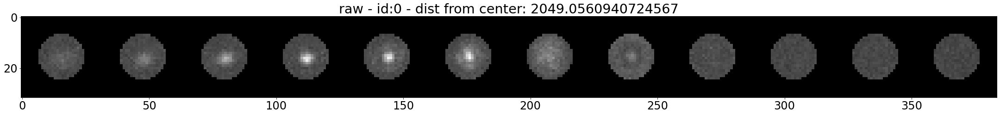

sub psf (32, 384)


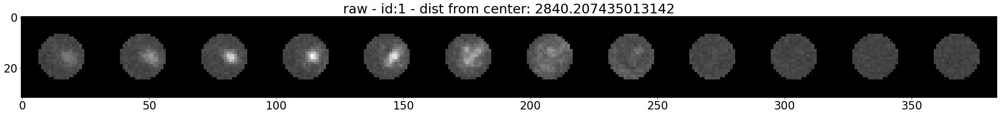

sub psf (32, 384)


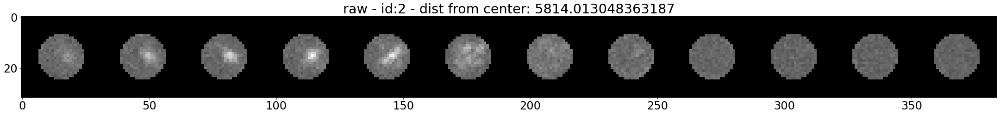

sub psf (32, 384)


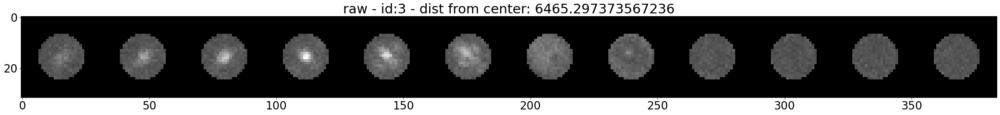

sub psf (32, 384)


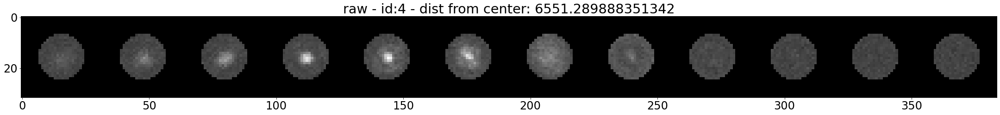

sub psf (32, 384)


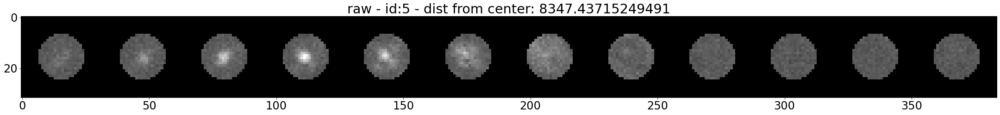

sub psf (32, 384)


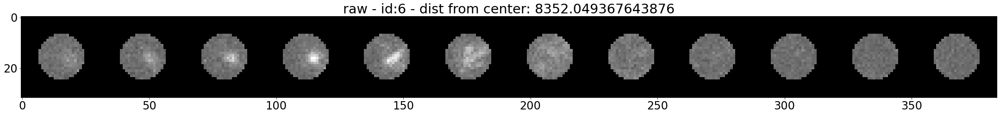

sub psf (32, 384)


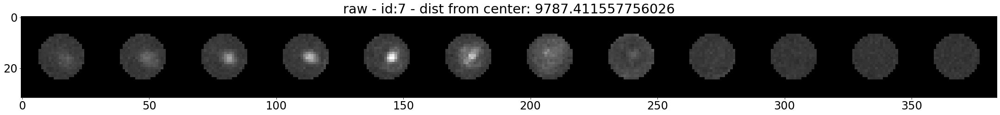

sub psf (32, 384)


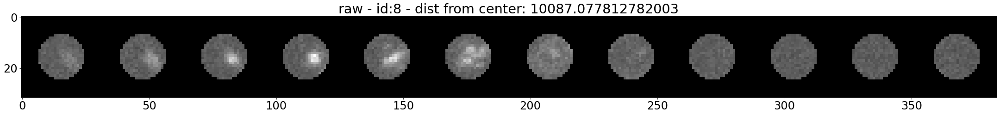

sub psf (32, 384)


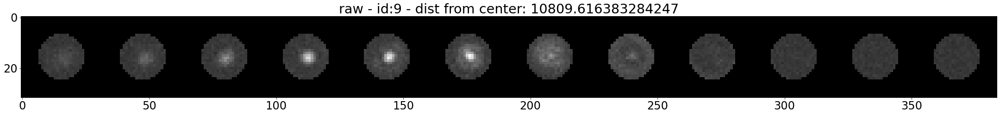

sub psf (32, 384)


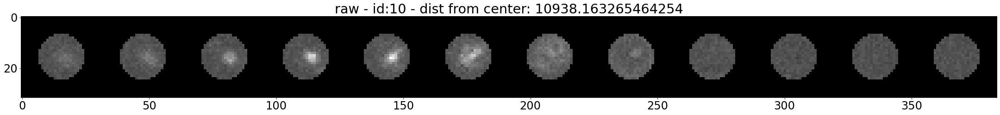

sub psf (32, 384)


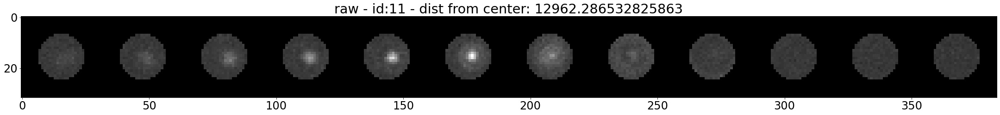

sub psf (32, 384)


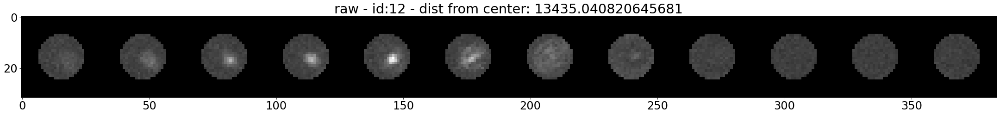

sub psf (32, 384)


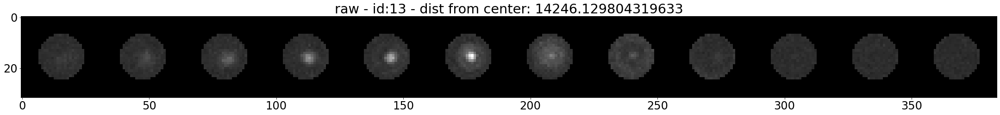

sub psf (32, 384)


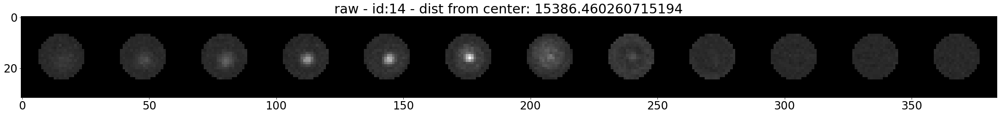

sub psf (32, 384)


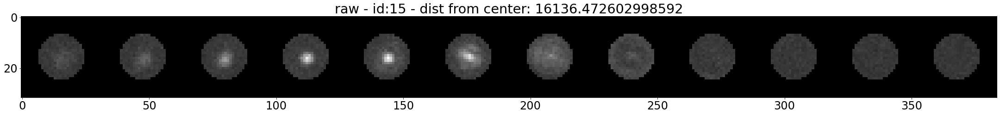

sub psf (32, 384)


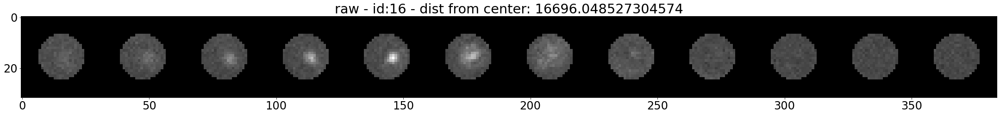

sub psf (32, 384)


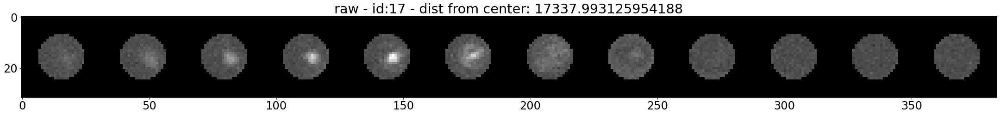

sub psf (32, 384)


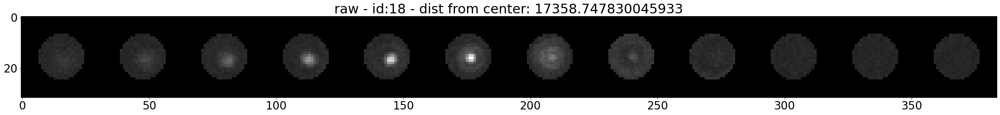

sub psf (32, 384)


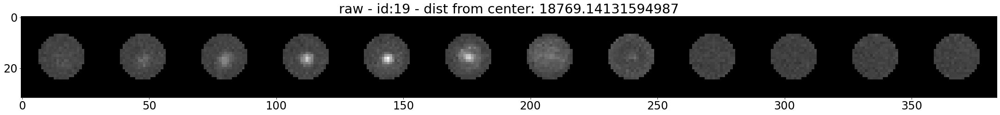

sub psf (32, 384)


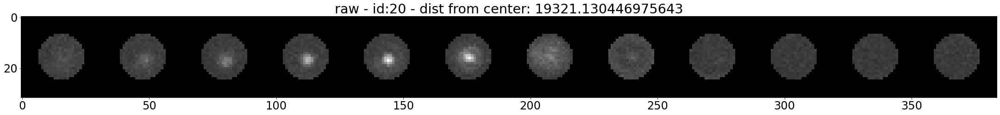

sub psf (32, 384)


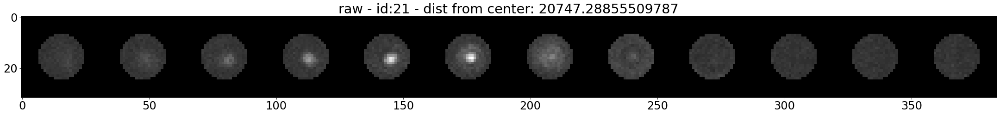

sub psf (32, 384)


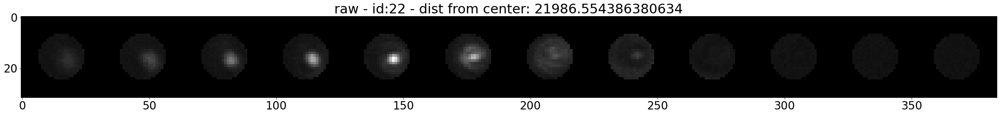

sub psf (32, 384)


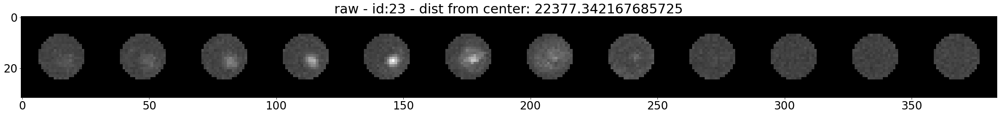

sub psf (32, 384)


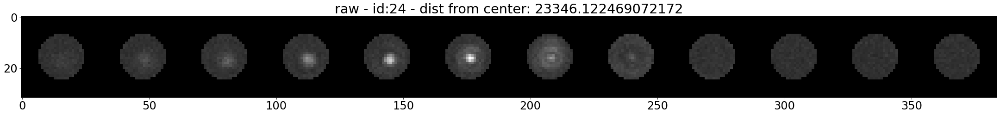

sub psf (32, 384)


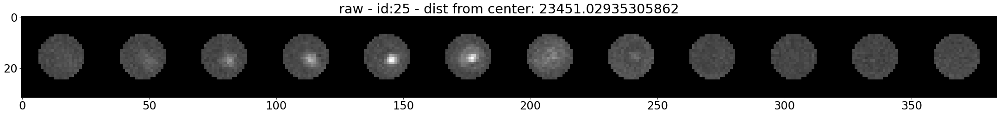

sub psf (32, 384)


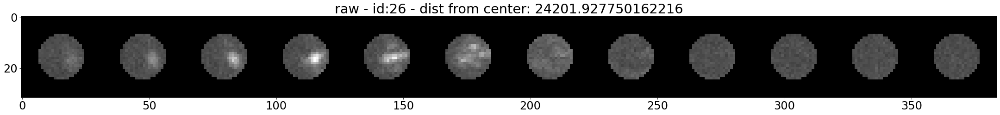

sub psf (32, 384)


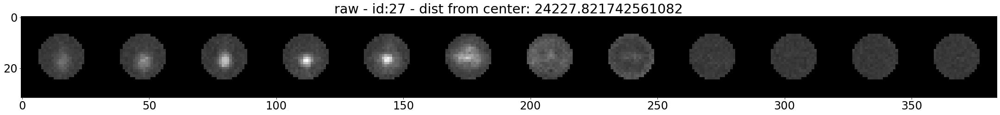

sub psf (32, 384)


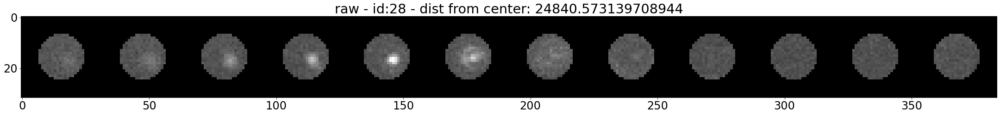

sub psf (32, 384)


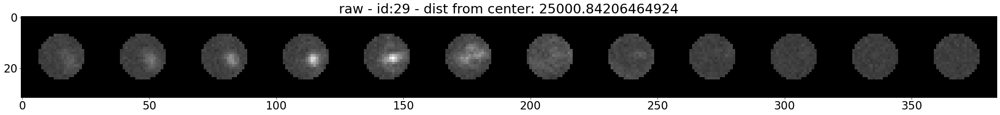

sub psf (32, 384)


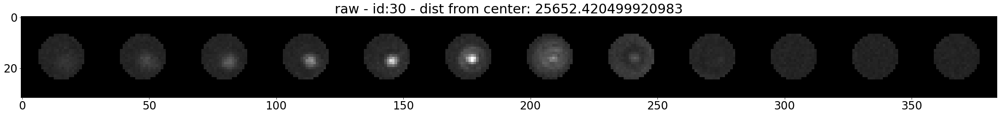

sub psf (32, 384)


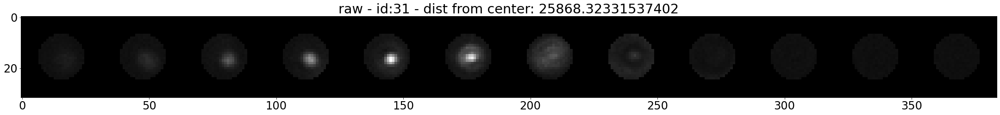

sub psf (32, 384)


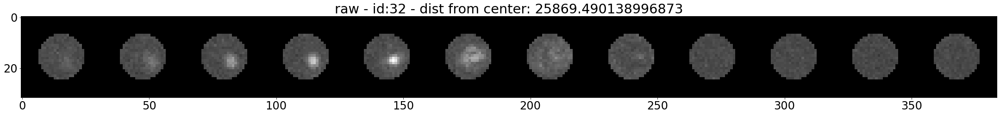

sub psf (32, 384)


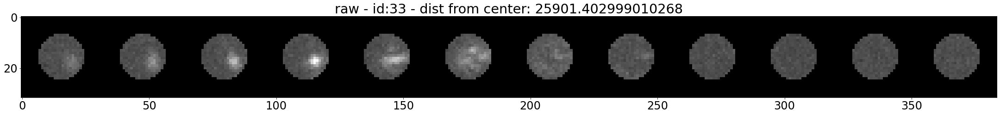

sub psf (32, 384)


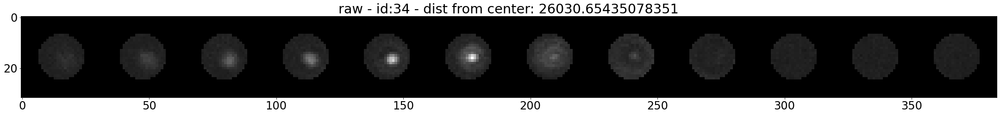

sub psf (32, 384)


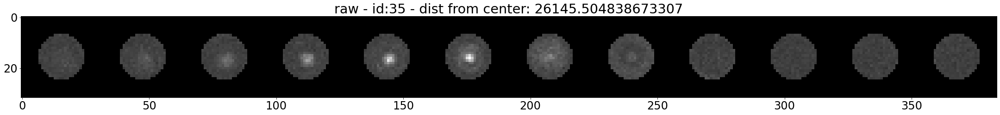

sub psf (32, 384)


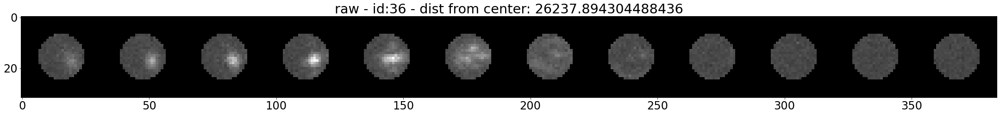

sub psf (32, 384)


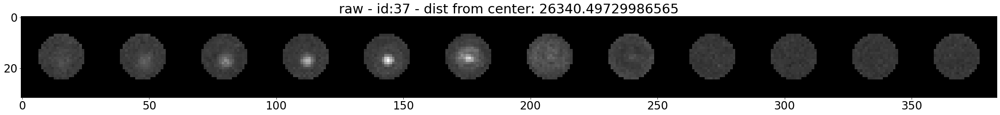

sub psf (32, 384)


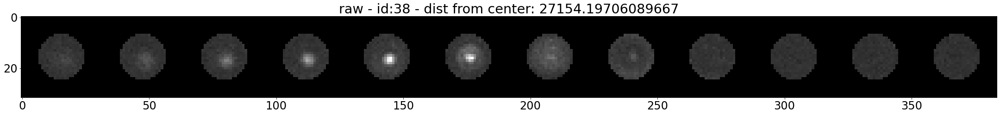

sub psf (32, 384)


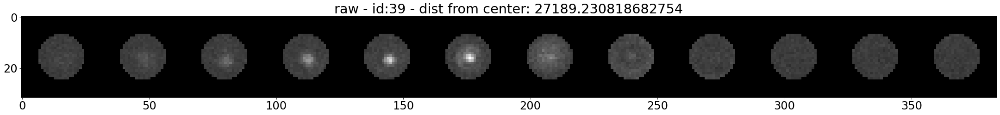

sub psf (32, 384)


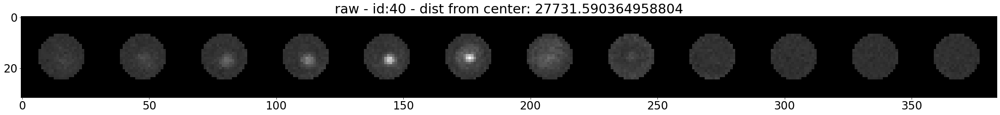

sub psf (32, 384)


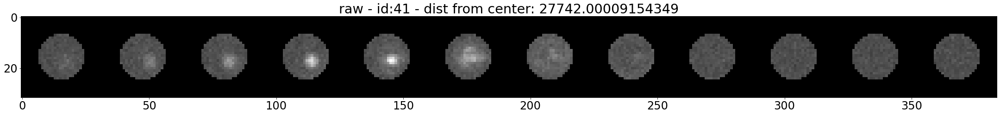

sub psf (32, 384)


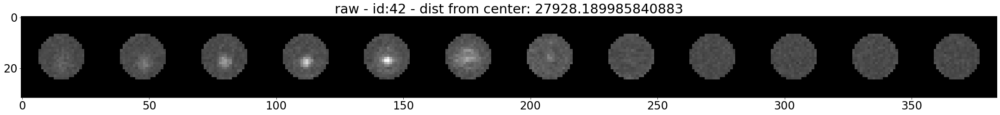

sub psf (32, 384)


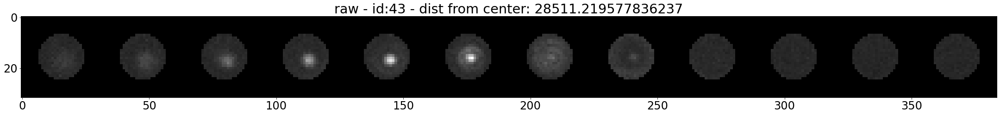

sub psf (32, 384)


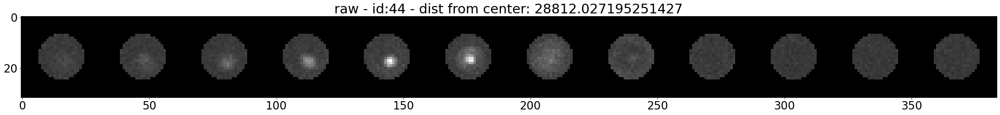

sub psf (32, 384)


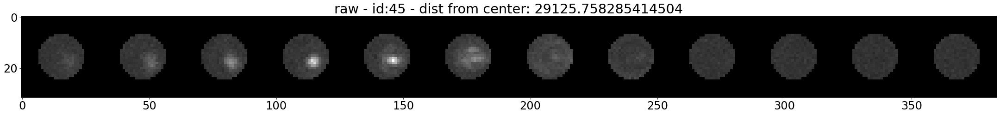

sub psf (32, 384)


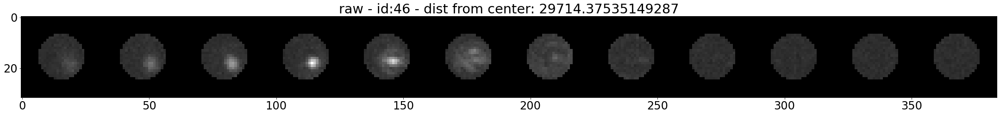

sub psf (32, 384)


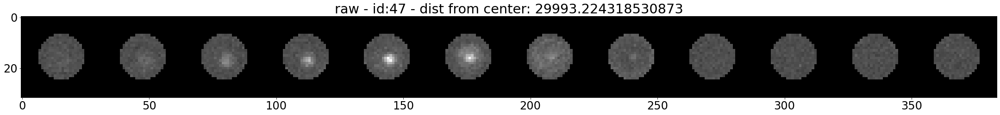

sub psf (32, 384)


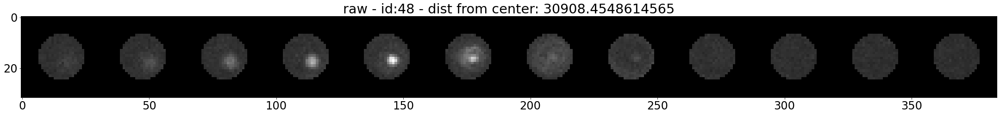

sub psf (32, 384)


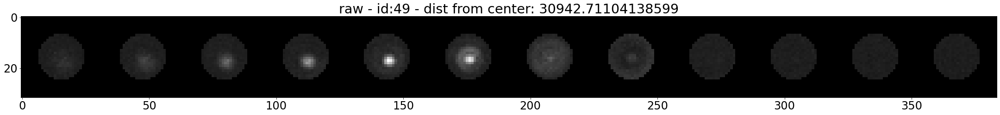

In [359]:
# for i in range(ds.csv_data.shape[0]):
#     psf = ds.debug_emitter(i, 1e10)[0]
#     mask_psf(psf)
#     show_psf_axial(psf, f'raw - id:{i} - dist from center: {ds.csv_data.iloc[i]["dist_center"]}', 10)


{'wl': 635, 'na': 1.4, 'ni': 1.51, 'res': 85.8, 'size': 40, 'zsize': 81, 'zres': 50, 'vec_corr': 'none', 'condition': 'none'}
sub psf (40, 1000)


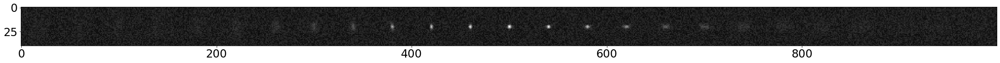

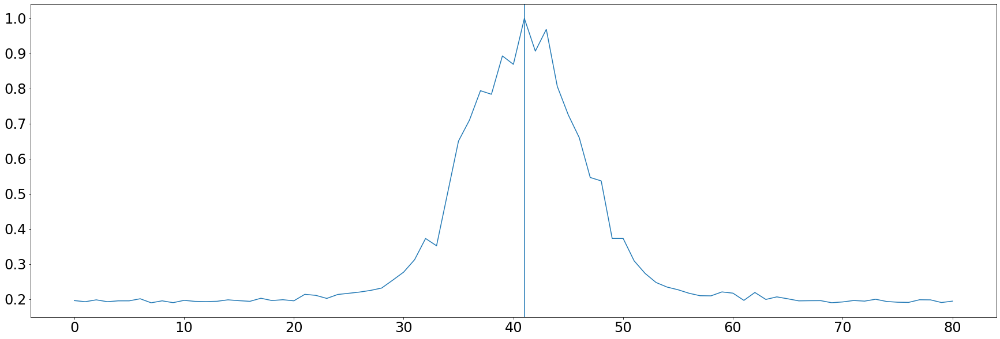

sub psf (40, 1000)


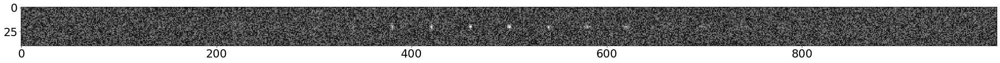

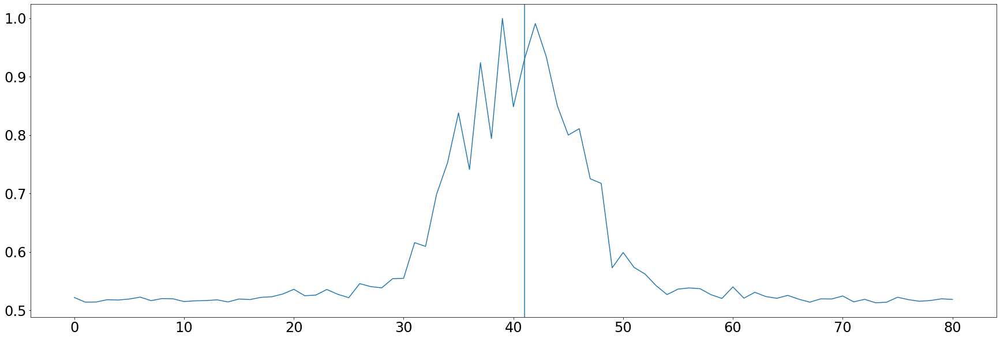

In [588]:
'''
Generate fake PSF dataset to try and align
 '''


from pyotf.otf import HanserPSF
from pyotf.otf import apply_named_aberration
from pyotf.otf import name2noll

model_kwargs['size'] = 40
model_kwargs['zsize'] = 81
print(model_kwargs)

psf_model = HanserPSF(**model_kwargs)
psf_model = apply_named_aberration(psf_model, 'vertical astigmatism', 1.0)
psf = psf_model.PSFi

psf = psf / psf.max()


psfs = []
N_PSFS = 1000

records = []
for i in range(N_PSFS):
    noise_level = np.random.uniform(0, 0.8)
    bg_noise = np.random.uniform(0.05, noise_level, size=psf.shape)
    noisy_psf = psf.copy() + bg_noise
    noisy_psf = noisy_psf / noisy_psf.max()
    noisy_psf = (noisy_psf * 255 * 255).astype(int)
    noisy_psf = np.random.poisson(noisy_psf)
    noisy_psf = noisy_psf.astype(float)
    noisy_psf = noisy_psf / noisy_psf.max()
    psfs.append(noisy_psf)
    records.append({
        'id': i,
        'noise_level': noise_level,
        'total_noise': bg_noise.sum()
    })

import pandas as pd
df = pd.DataFrame.from_records(records)

for psf in psfs[0:2]:
    show_psf_axial(psf, '', 2)
    plt.plot(psf.max(axis=(1,2)))
    plt.axvline(x=(psf.shape[0]+1)/2)
    plt.show()
    


/home/miguel/Projects/uni/venv/lib/python3.8/site-packages/scipy/interpolate/_fitpack2.py:280: UserWarning: 
The maximal number of iterations maxit (set to 20 by the program)
allowed for finding a smoothing spline with fp=s has been reached: s
too small.
There is an approximation returned but the corresponding weighted sum
of squared residuals does not satisfy the condition abs(fp-s)/s < tol.
  warnings.warn(message)


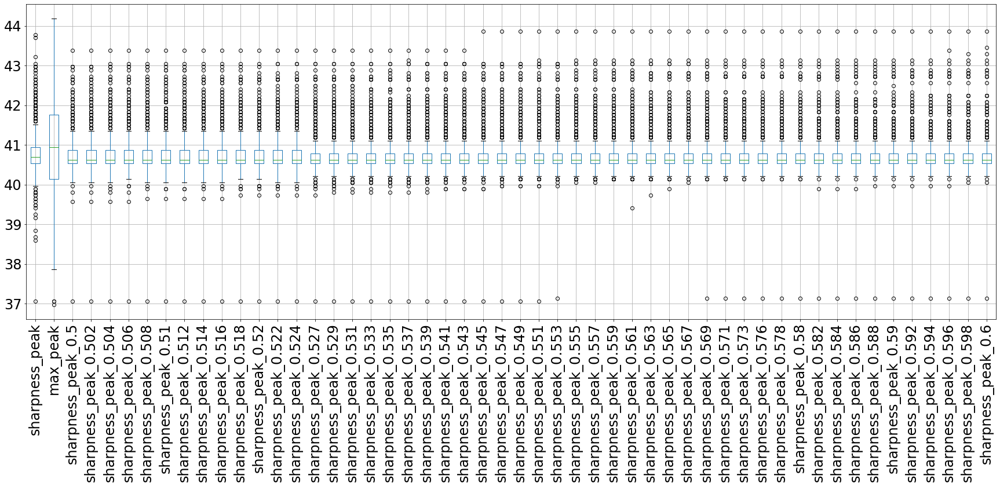

sharpness_peak 40.84119 0.57589
max_peak 40.95097 1.11272
sharpness_peak_0.5 40.73173 0.41348
sharpness_peak_0.502 40.73076 0.41353
sharpness_peak_0.504 40.73076 0.41485
sharpness_peak_0.506 40.73084 0.41296
sharpness_peak_0.508 40.73157 0.41276
sharpness_peak_0.51 40.72881 0.41059
sharpness_peak_0.512 40.72881 0.41069
sharpness_peak_0.514 40.72622 0.40622
sharpness_peak_0.516 40.72492 0.40464
sharpness_peak_0.518 40.72411 0.40503
sharpness_peak_0.52 40.72338 0.40411
sharpness_peak_0.522 40.72281 0.40382
sharpness_peak_0.524 40.7207 0.40275
sharpness_peak_0.527 40.71949 0.407
sharpness_peak_0.529 40.71762 0.40551
sharpness_peak_0.531 40.71681 0.404
sharpness_peak_0.533 40.71649 0.40215
sharpness_peak_0.535 40.71624 0.40267
sharpness_peak_0.537 40.71665 0.40501
sharpness_peak_0.539 40.71551 0.40349
sharpness_peak_0.541 40.71511 0.402
sharpness_peak_0.543 40.71324 0.39973
sharpness_peak_0.545 40.71316 0.40196
sharpness_peak_0.547 40.71178 0.40108
sharpness_peak_0.549 40.71146 0.40022
sha

In [594]:
import pandas as pd

def get_img_gradient(img):
    gy, gx = np.gradient(img)
    gnorm = np.sqrt(gx**2 + gy**2)
    sharpness = np.average(gnorm)
    return sharpness


x = np.arange(0, psfs[0].shape[0])
sub_x = np.linspace(0, psfs[0].shape[0], 1000, endpoint=True)


def fit_cubic_spline(axial_max, s=0.05):
    cs = UnivariateSpline(x, axial_max, k=3, s=s)
    return norm_zero_one(cs(sub_x))

def get_sharpness(psf):
    return norm_zero_one(np.array([get_img_gradient(img) for img in psf]))
    
def get_peak_sharpness(psf):
    sharpness = get_sharpness(psf)
    cubic_sharpness = fit_cubic_spline(sharpness, s=0.58)
    sharpness_peak = sub_x[np.argmax(cubic_sharpness)]
    return sharpness_peak*ds.voxel_sizes[0]

def fit_psf(psf):
    psf = butter_psf(psf)
        
    sharpness = get_sharpness(psf)
    
    cubic_sharpness = fit_cubic_spline(sharpness, s=0.3)
    
    squared_sum_axial = np.sum(np.power(psf, 2), axis=(1,2))
    squared_sum_axial = norm_zero_one(squared_sum_axial)
    squared_sum_axial = fit_cubic_spline(squared_sum_axial, s=1e-4)

#     show_psf_axial(np.power(psf, 2), '', 2)
#     plt.plot(x, sharpness, label='raw_sharp')
#     plt.plot(sub_x, cubic_sharpness, label='sharpness')
#     plt.plot(x, psf.max(axis=(1,2)), label='intensity')
#     plt.plot(sub_x, squared_sum_axial, label='squared_max')
#     plt.legend()
#     plt.show()


    sharpness_peak = sub_x[np.argmax(cubic_sharpness)]
    max_peak = sub_x[np.argmax(squared_sum_axial)]
    res = dict()
    res['sharpness_peak'] = sharpness_peak
    res['max_peak'] = max_peak
    
    
    for s in np.linspace(0.5, 0.6, 50):
        cubic_sharpness = fit_cubic_spline(sharpness, s=s)
        res[f'sharpness_peak_{round(s, 3)}'] = sub_x[np.argmax(cubic_sharpness)]
    return res

records = [fit_psf(psfs[i]) for i in range(len(psfs))]

df = pd.DataFrame.from_records(records)
df.boxplot()
plt.xticks(rotation=90)
plt.show()
for col in list(df):
    print(col, round(df[col].mean(), 5), round(df[col].std(), 5))
    
    
# s = 0.58

sub psf (32, 576)


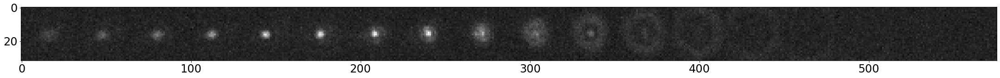

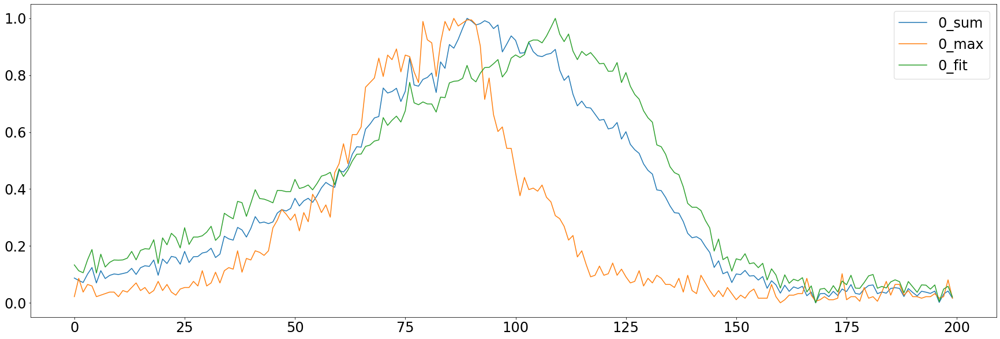

sub psf (32, 576)


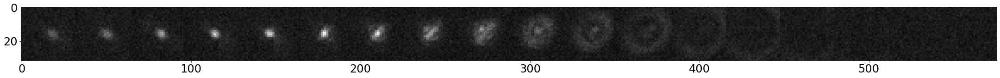

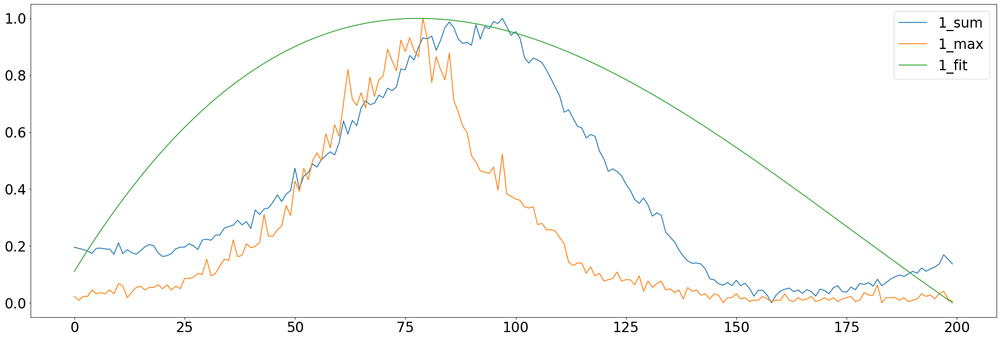

sub psf (32, 576)


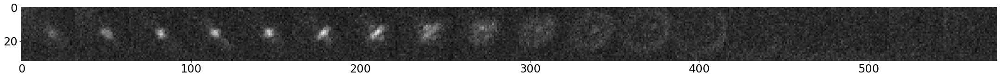

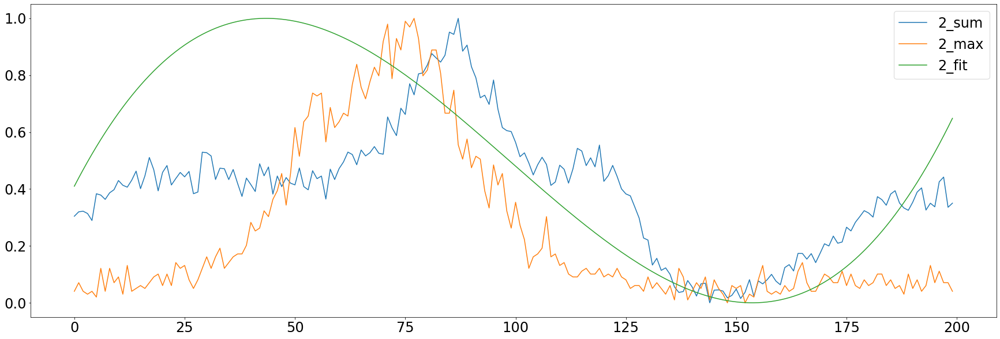

sub psf (32, 576)


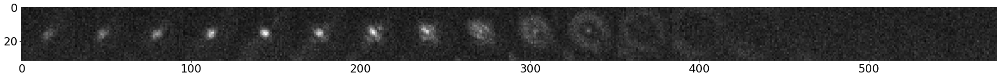

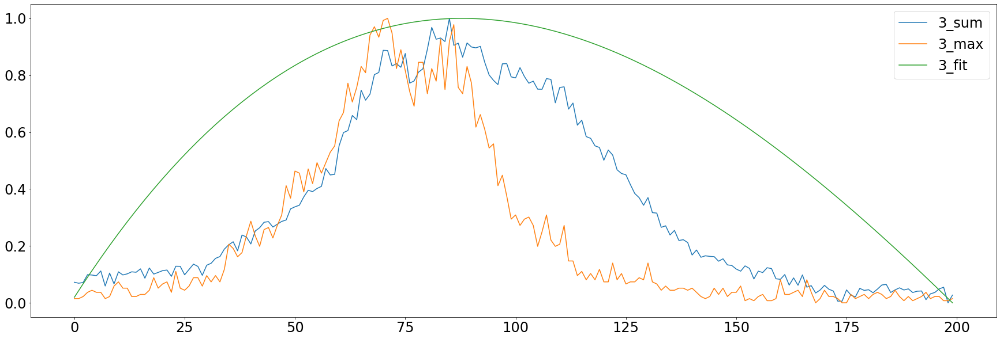

sub psf (32, 576)


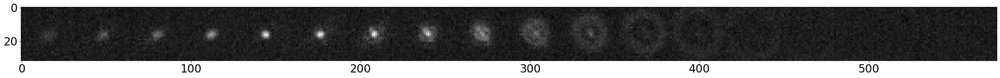

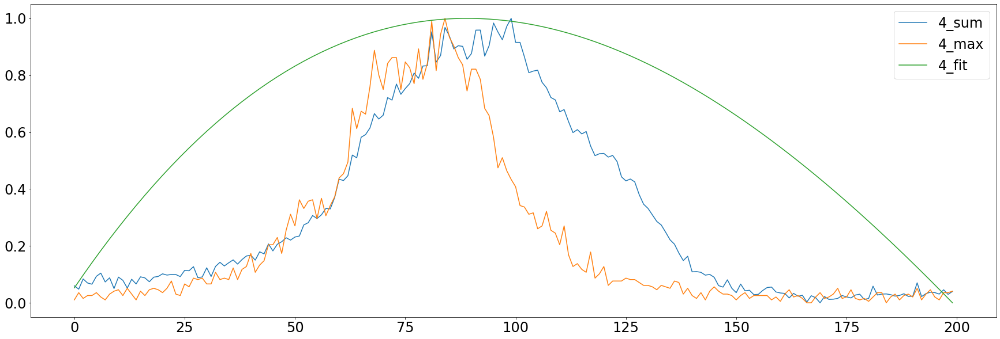

sub psf (32, 576)


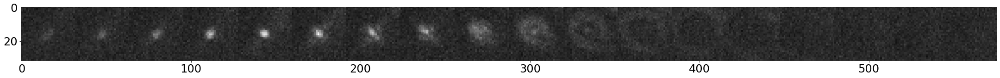

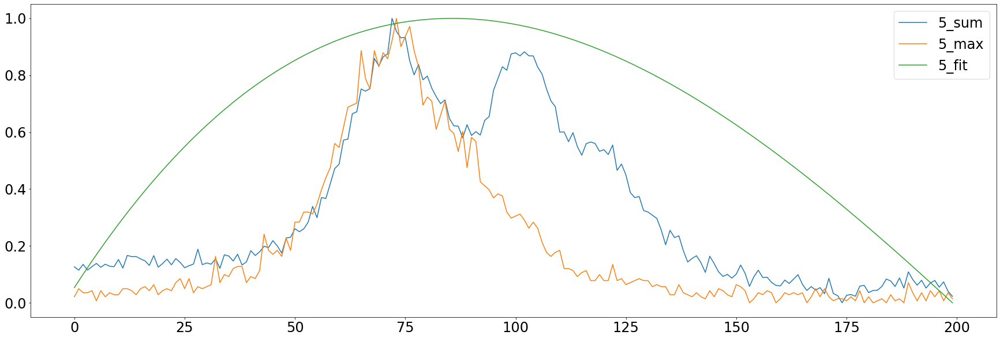

sub psf (32, 576)


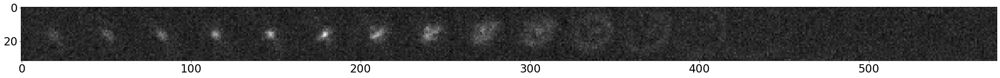

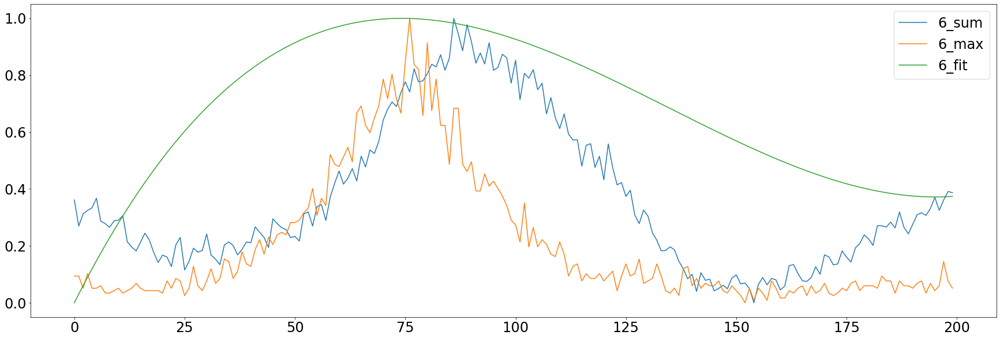

sub psf (32, 576)


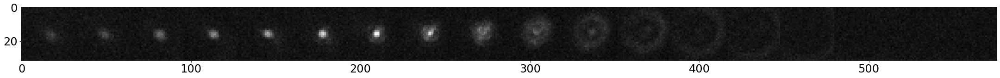

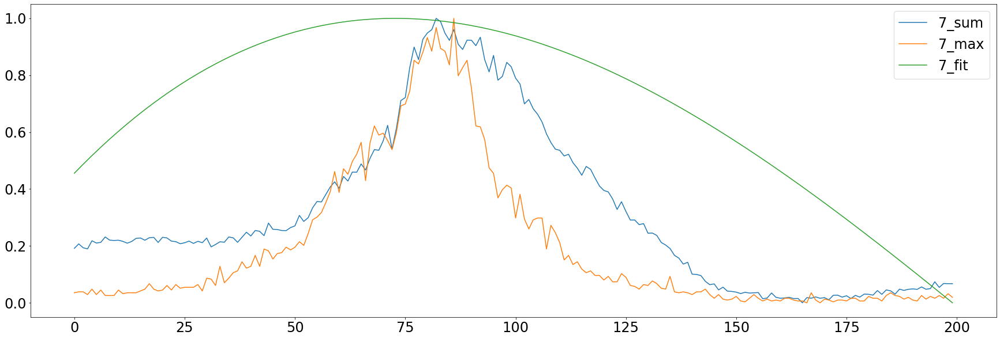

sub psf (32, 576)


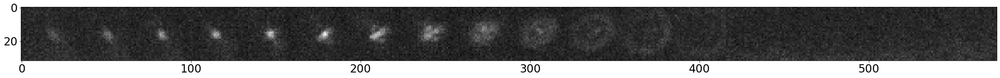

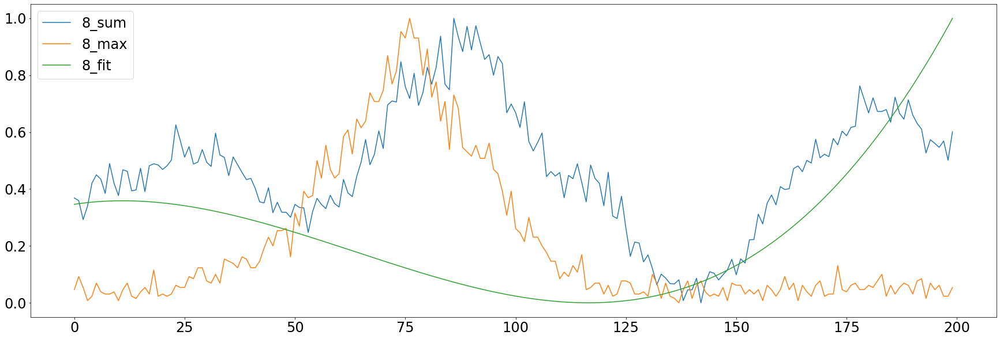

sub psf (32, 576)


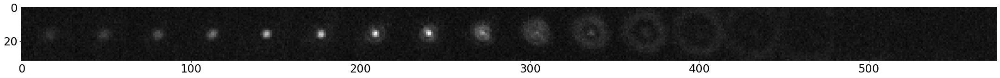

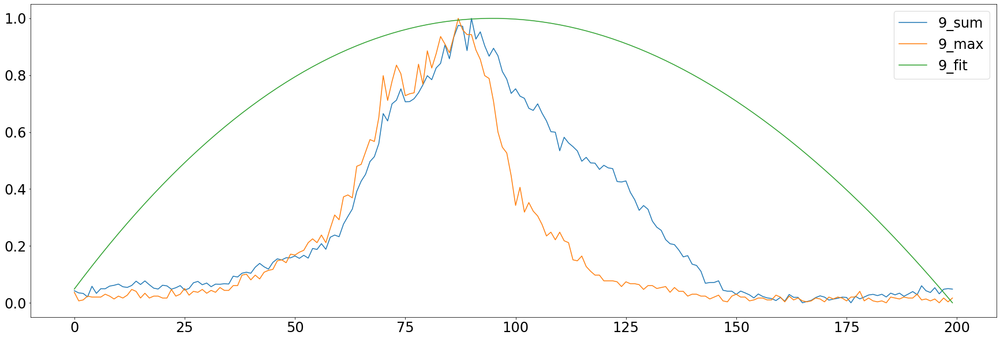

sub psf (32, 576)


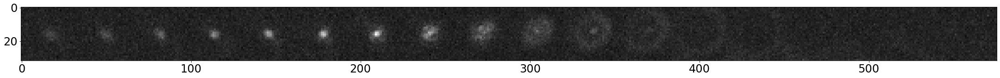

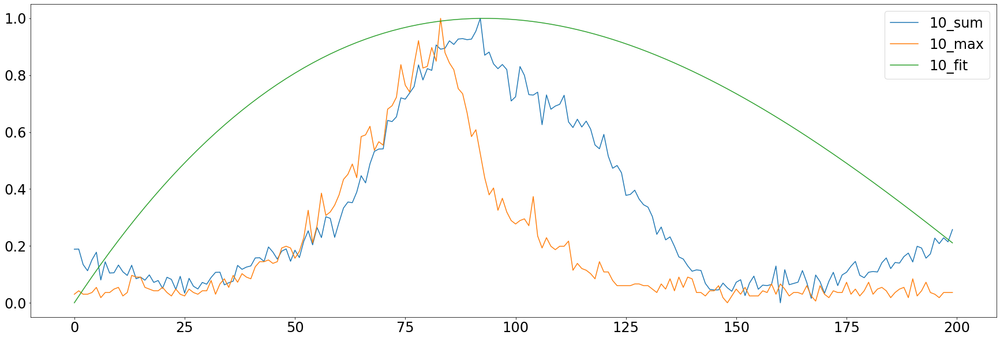

sub psf (32, 576)


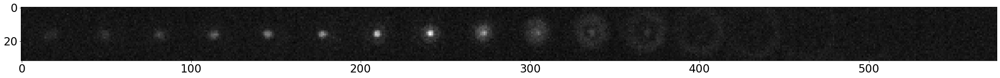

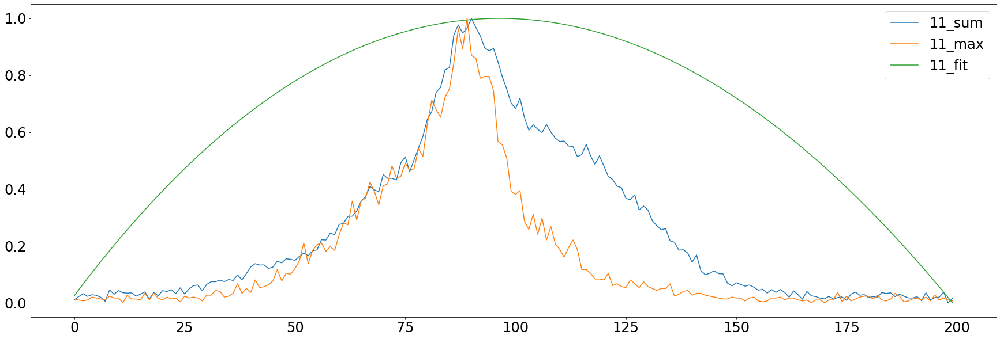

sub psf (32, 576)


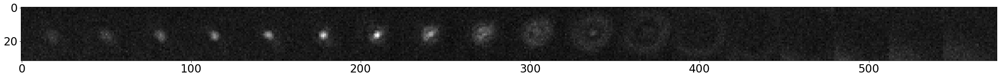

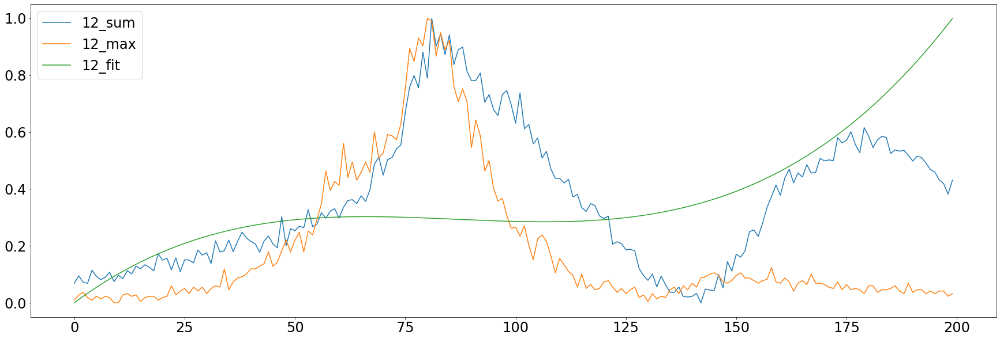

sub psf (32, 576)


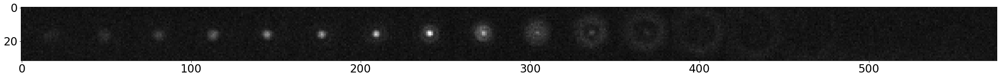

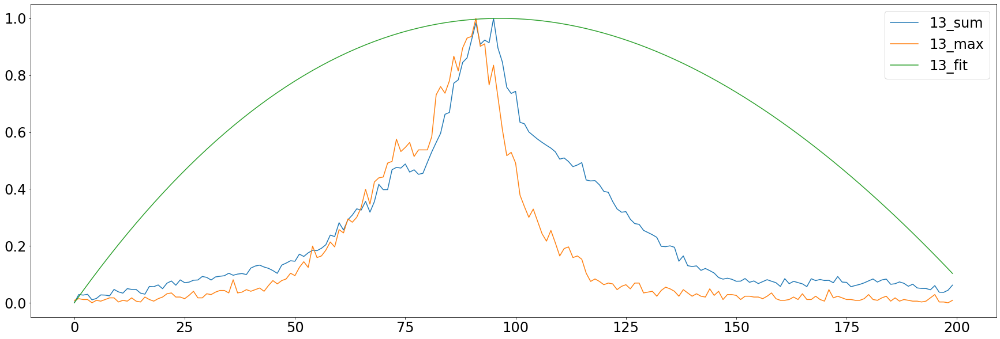

sub psf (32, 576)


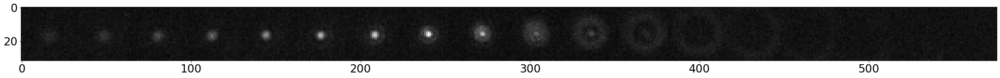

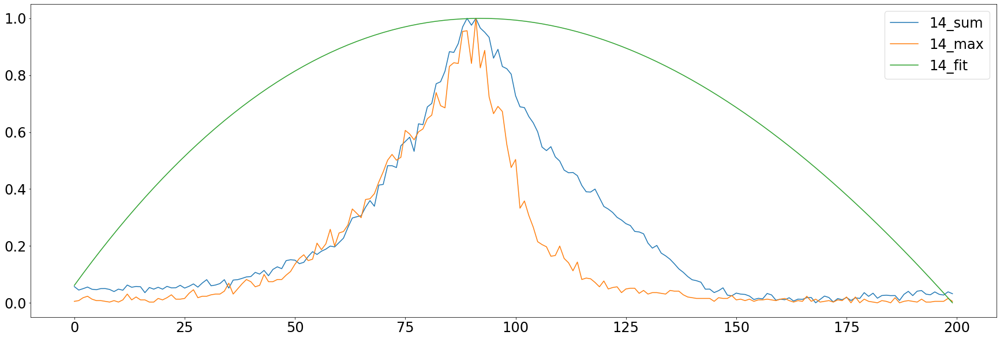

sub psf (32, 576)


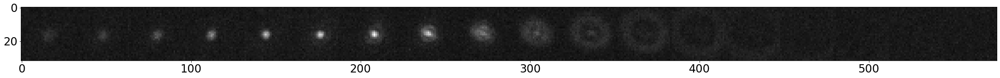

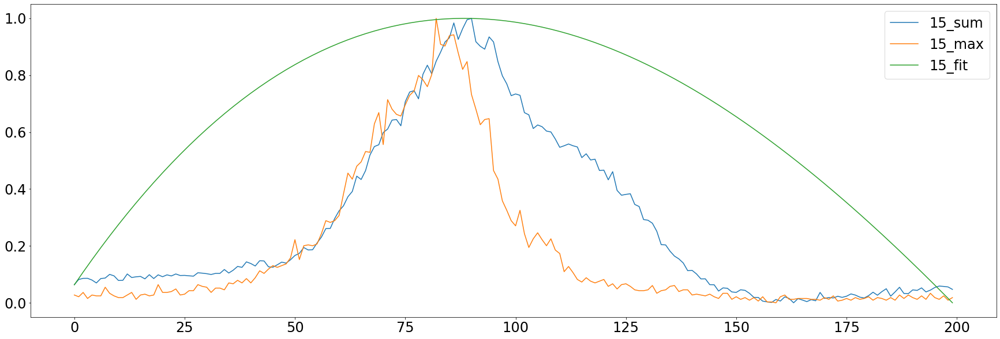

sub psf (32, 576)


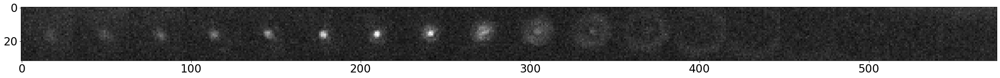

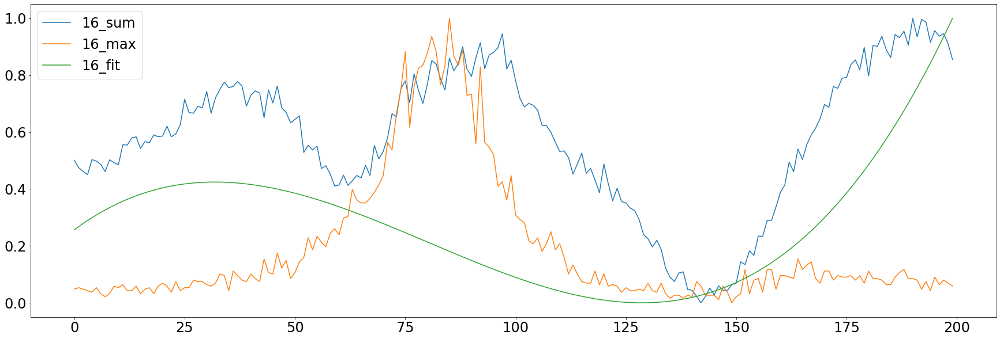

sub psf (32, 576)


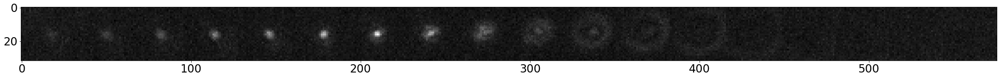

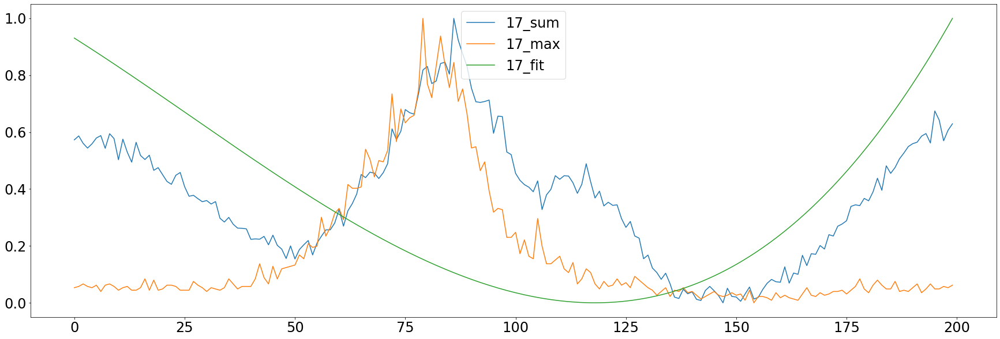

sub psf (32, 576)


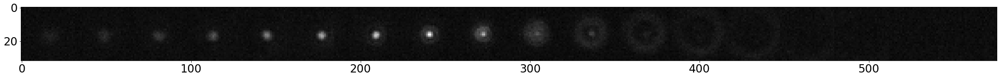

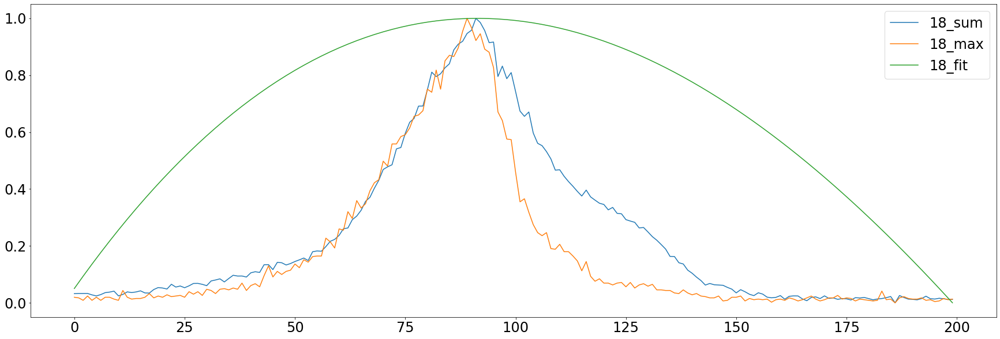

sub psf (32, 576)


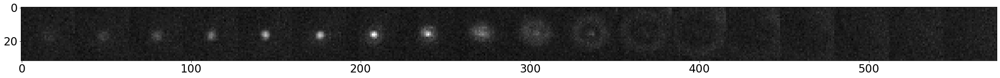

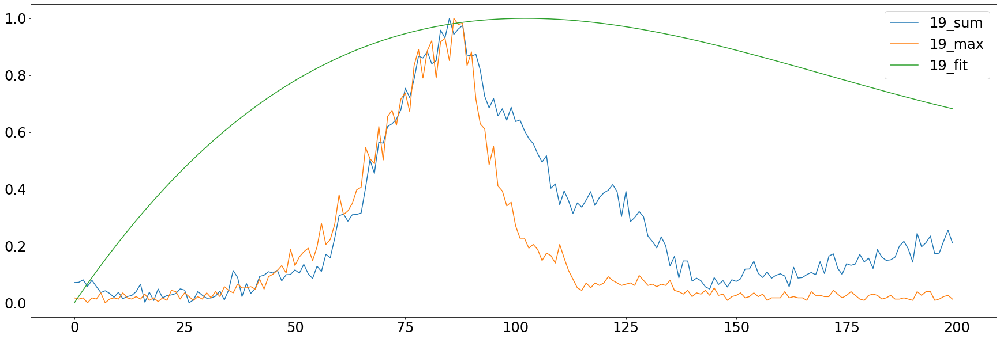

sub psf (32, 576)


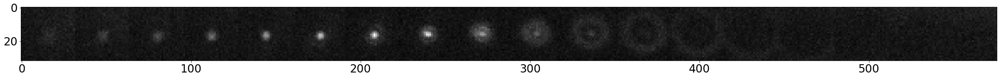

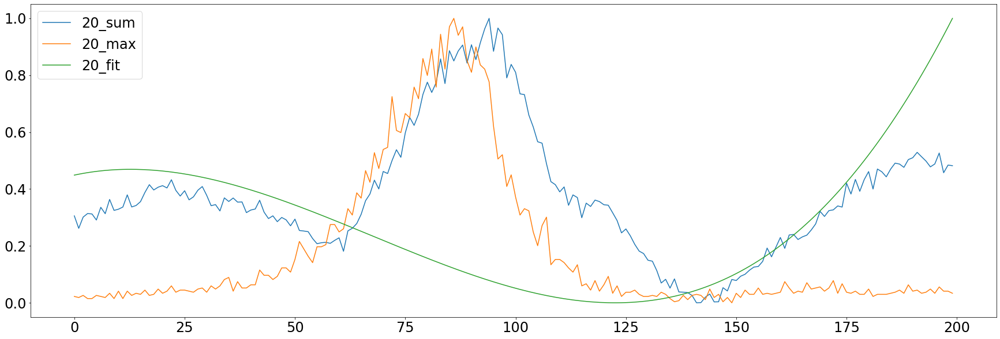

sub psf (32, 576)


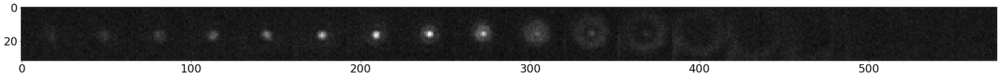

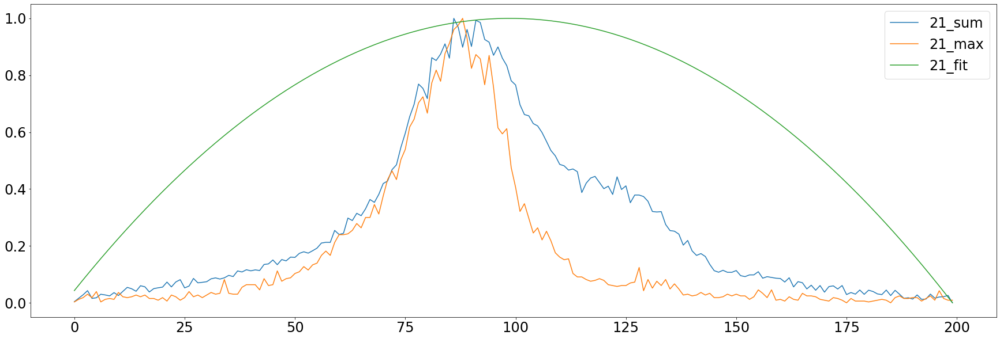

sub psf (32, 576)


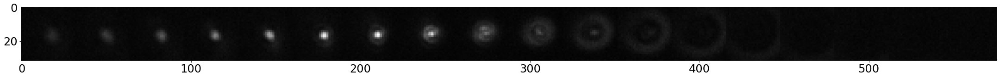

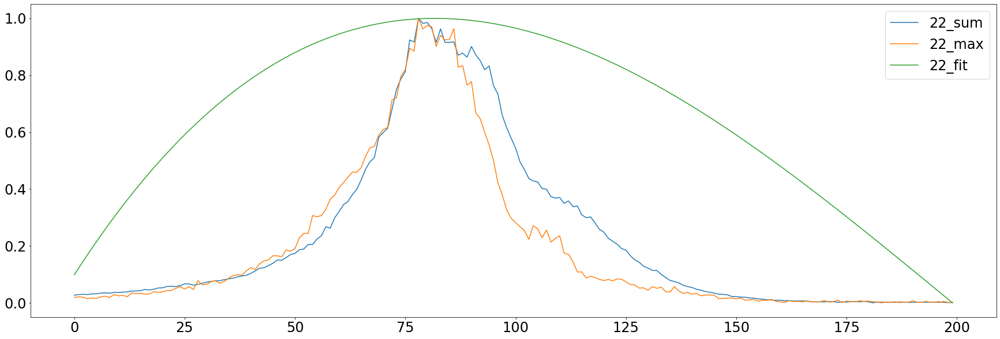

sub psf (32, 576)


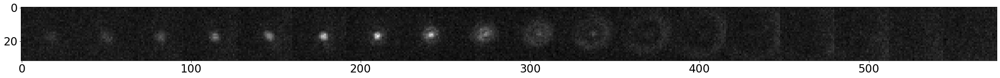

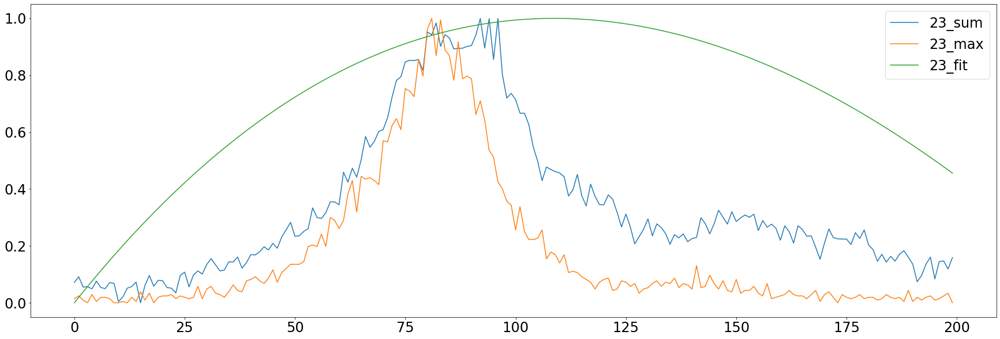

sub psf (32, 576)


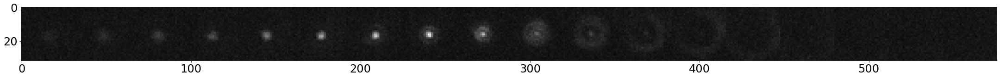

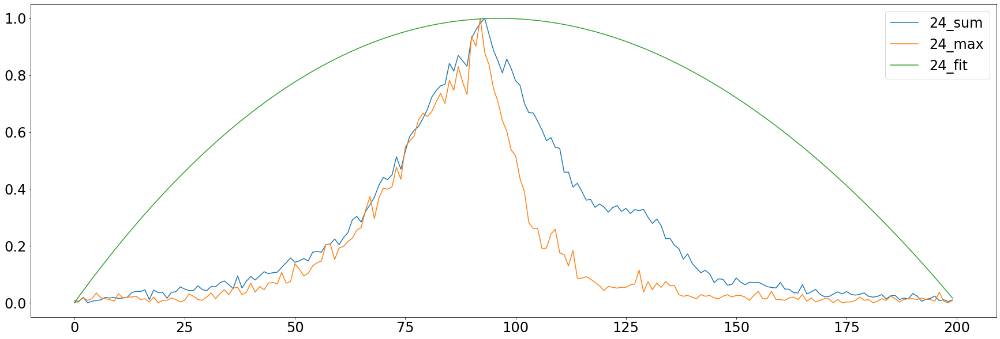

sub psf (32, 576)


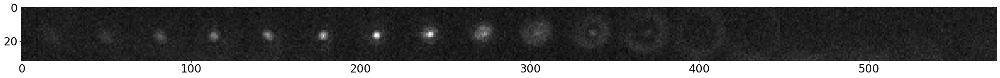

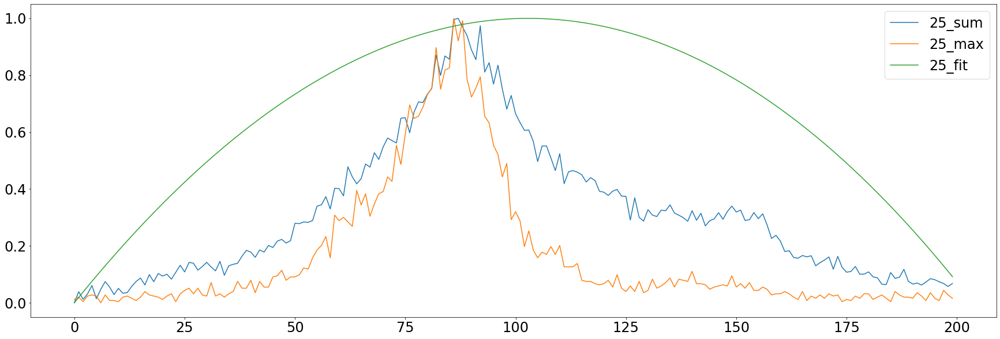

sub psf (32, 576)


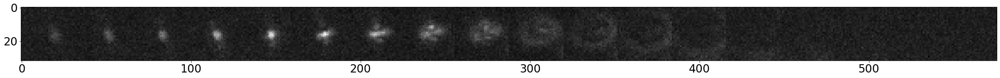

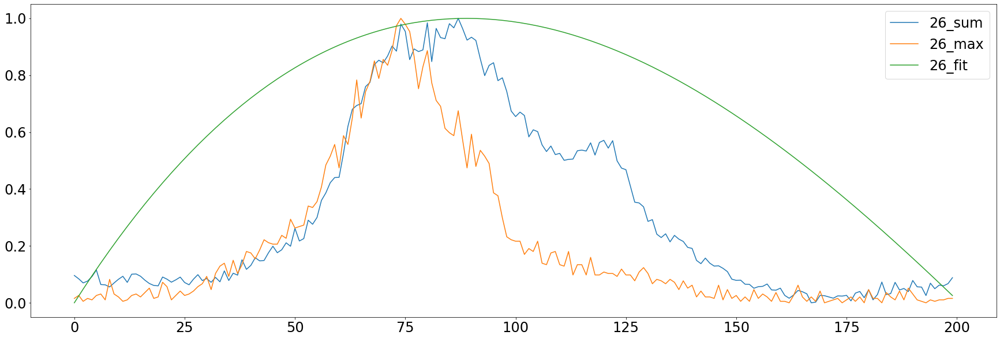

sub psf (32, 576)


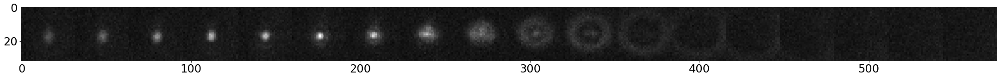

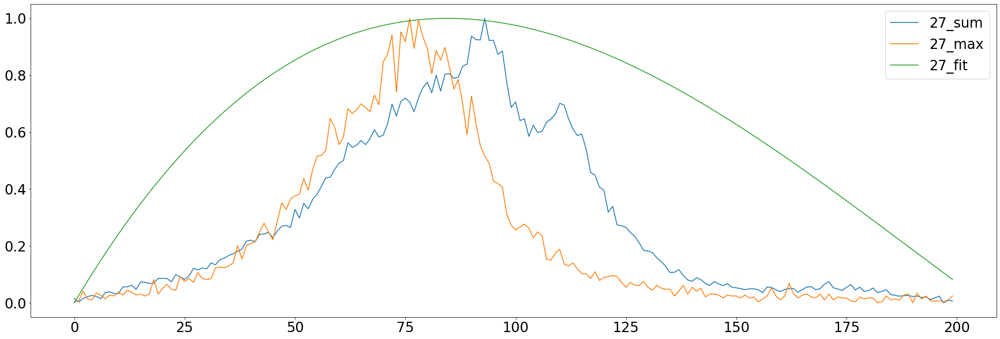

sub psf (32, 576)


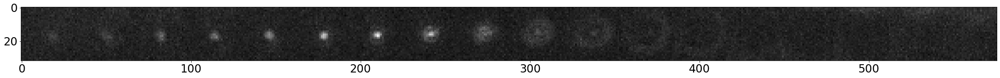

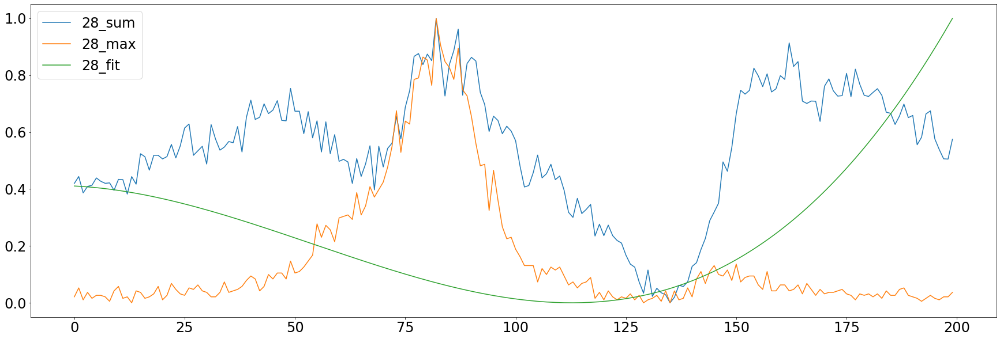

sub psf (32, 576)


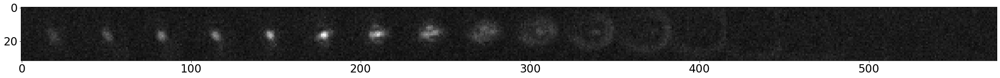

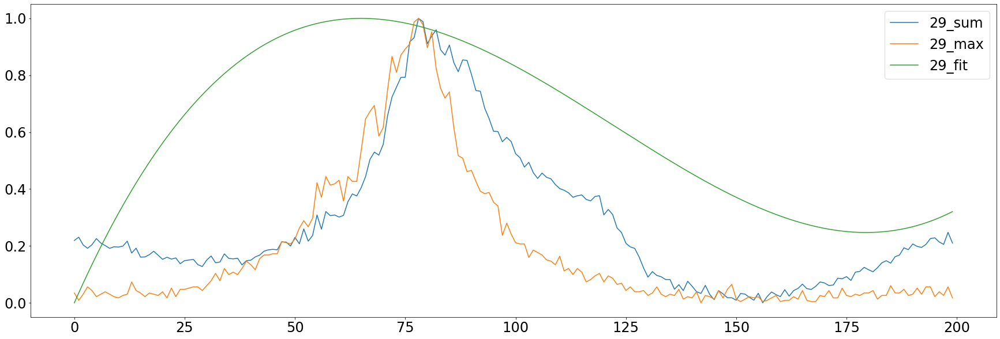

sub psf (32, 576)


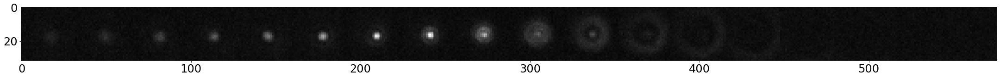

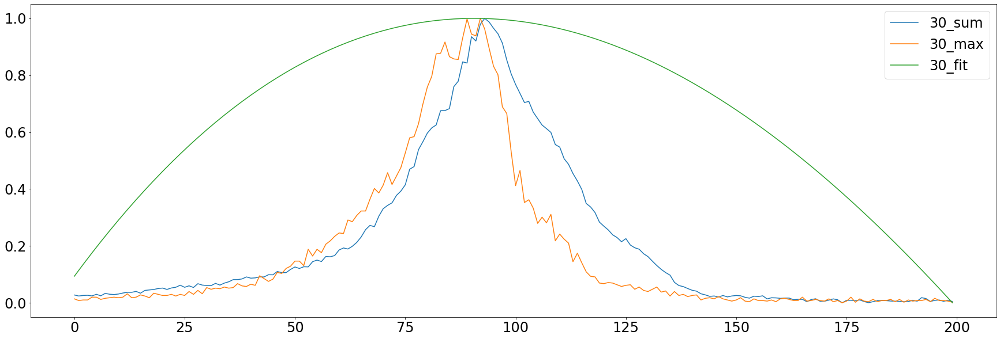

sub psf (32, 576)


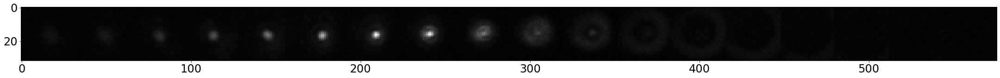

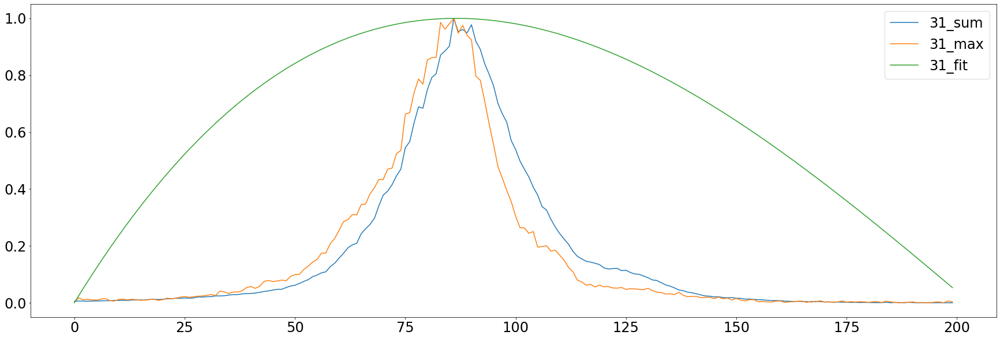

sub psf (32, 576)


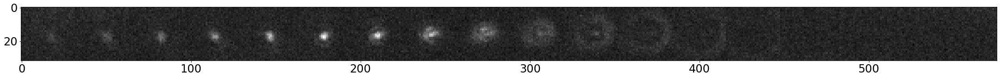

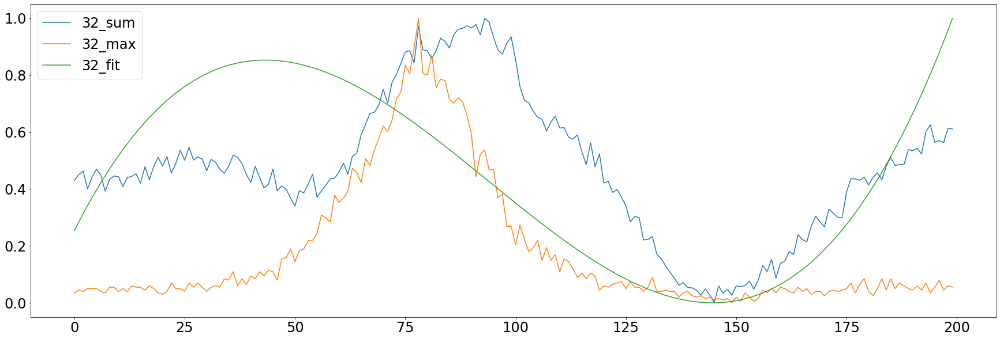

sub psf (32, 576)


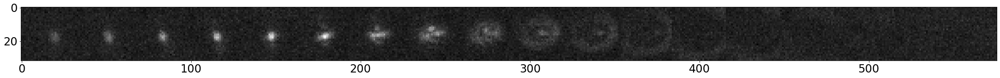

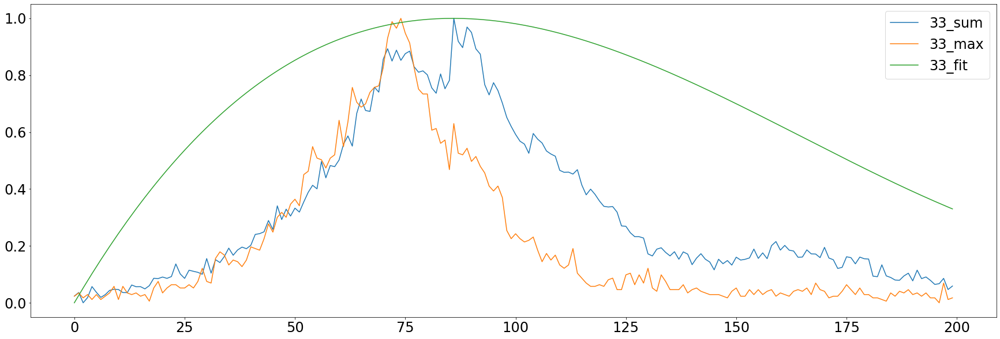

sub psf (32, 576)


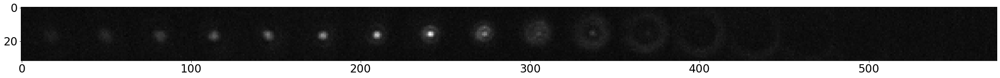

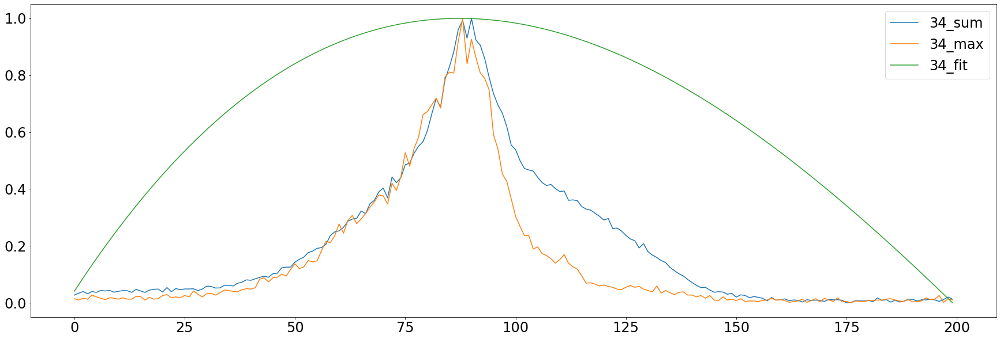

sub psf (32, 576)


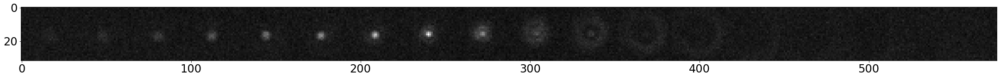

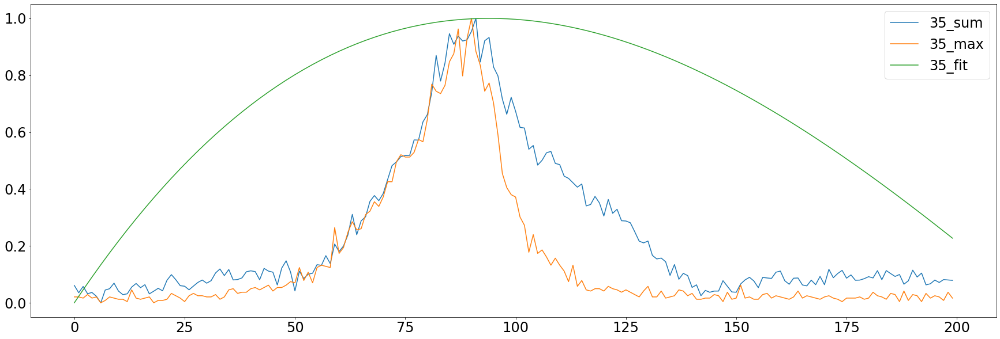

sub psf (32, 576)


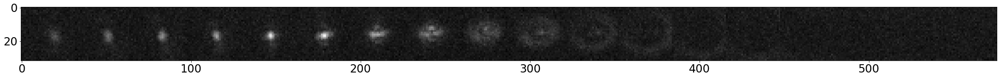

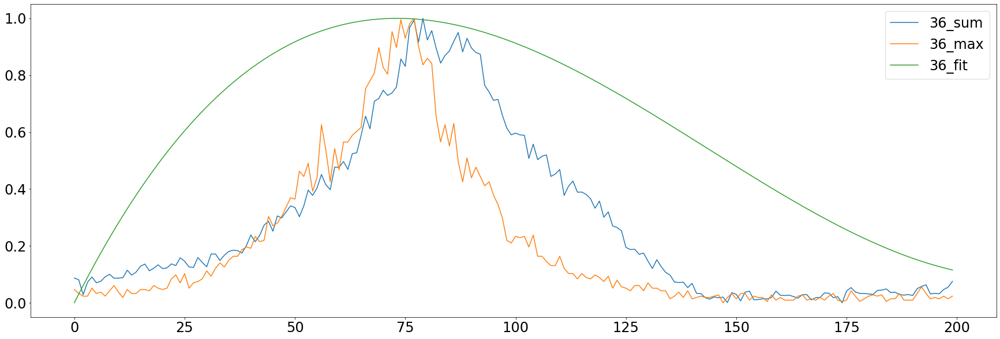

sub psf (32, 576)


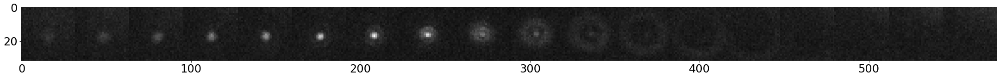

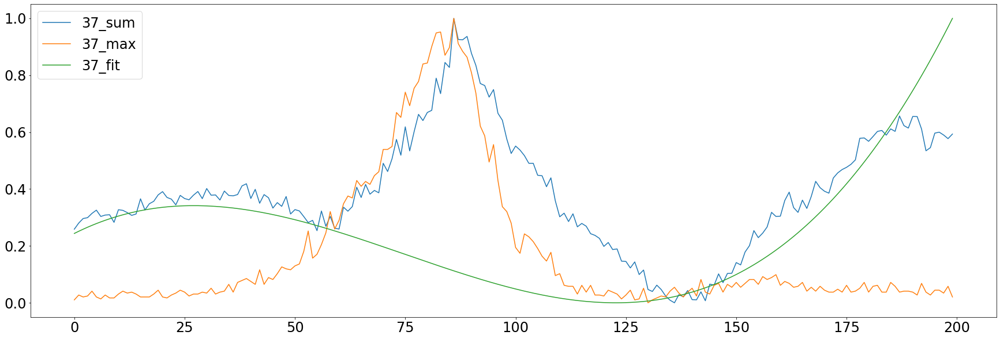

sub psf (32, 576)


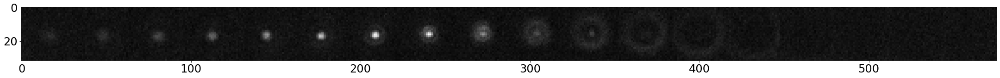

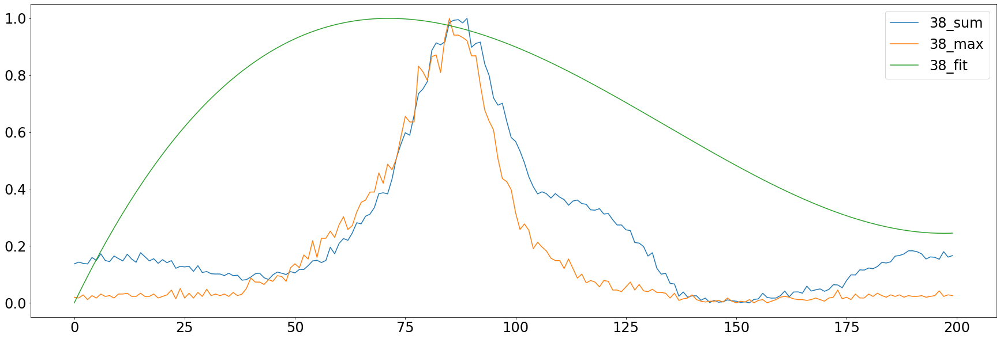

sub psf (32, 576)


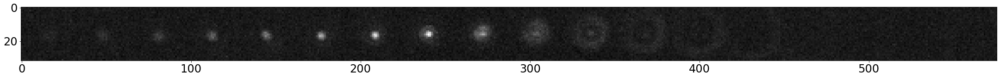

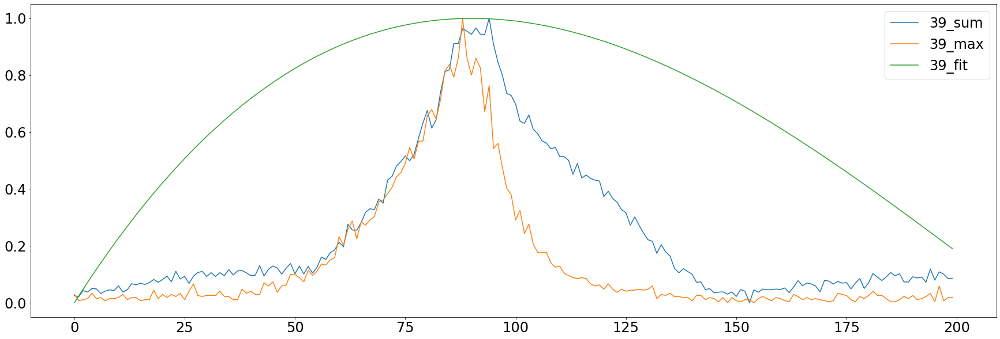

sub psf (32, 576)


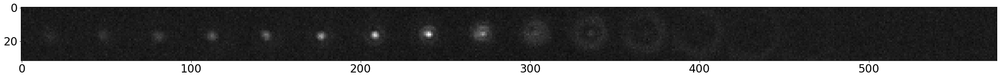

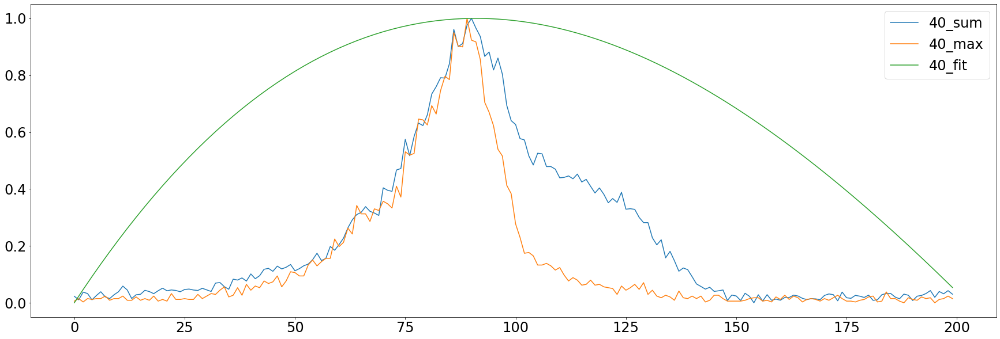

sub psf (32, 576)


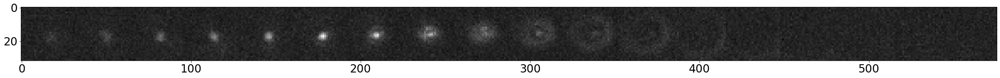

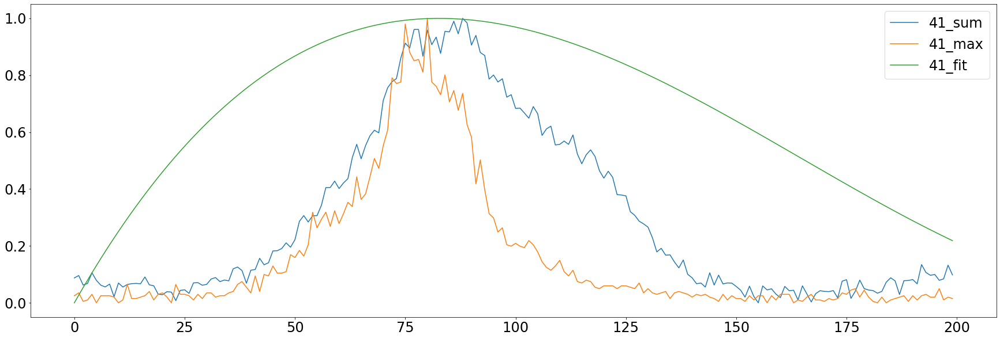

sub psf (32, 576)


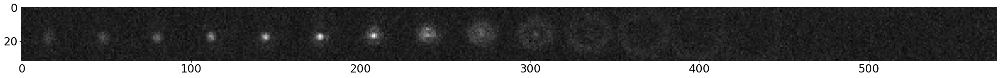

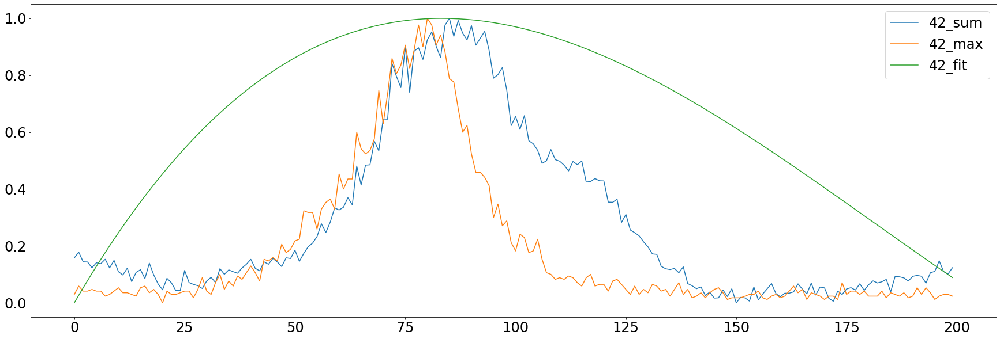

sub psf (32, 576)


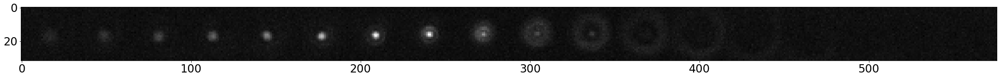

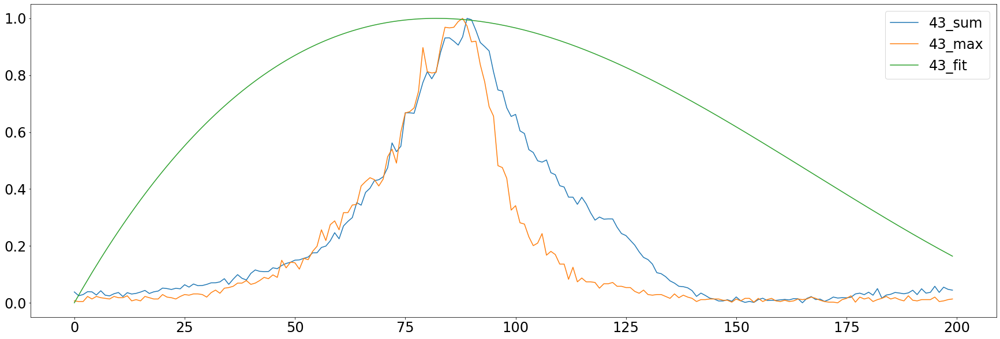

sub psf (32, 576)


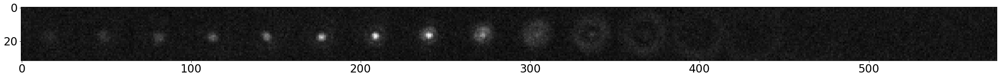

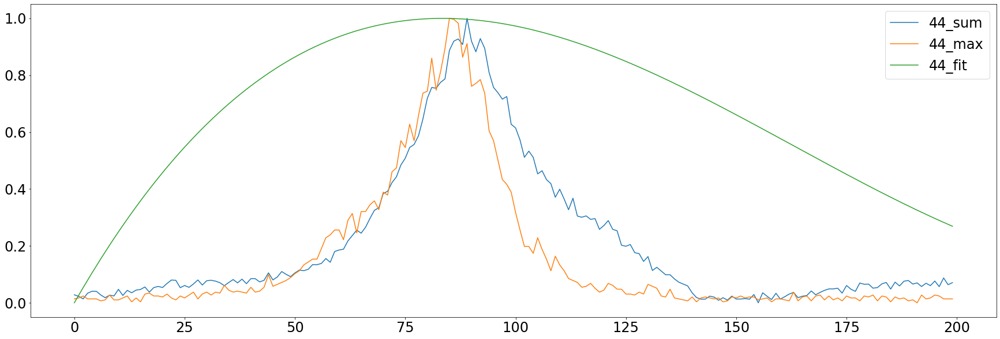

sub psf (32, 576)


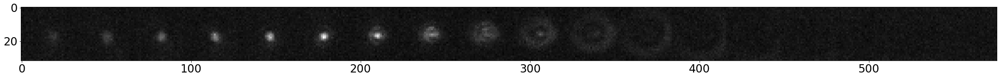

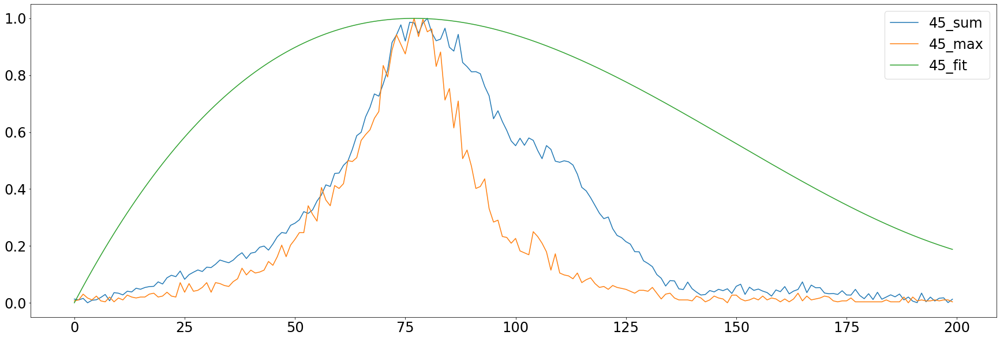

sub psf (32, 576)


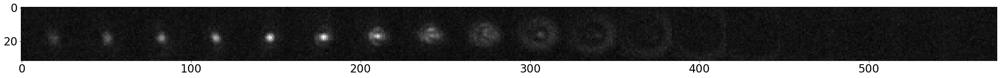

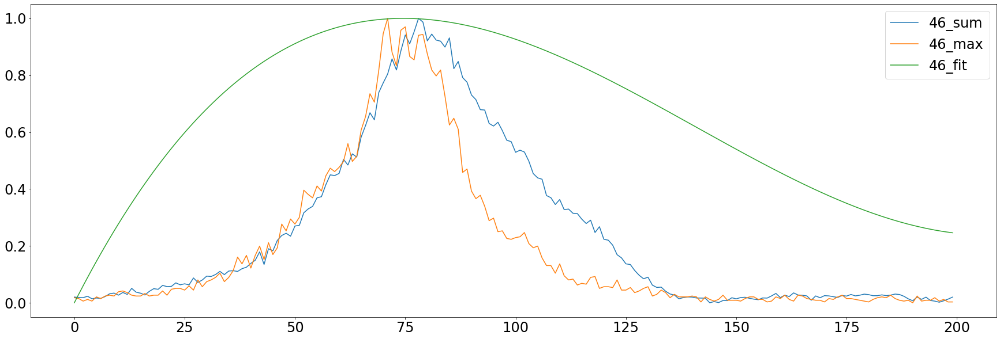

sub psf (32, 576)


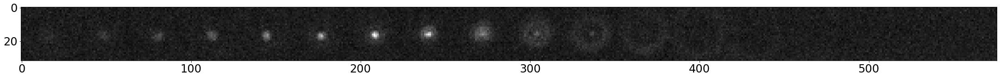

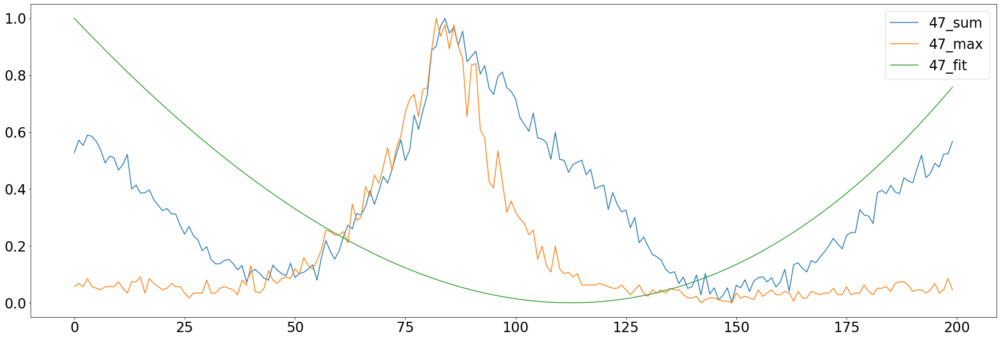

sub psf (32, 576)


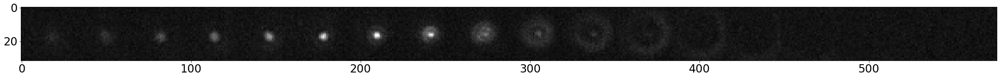

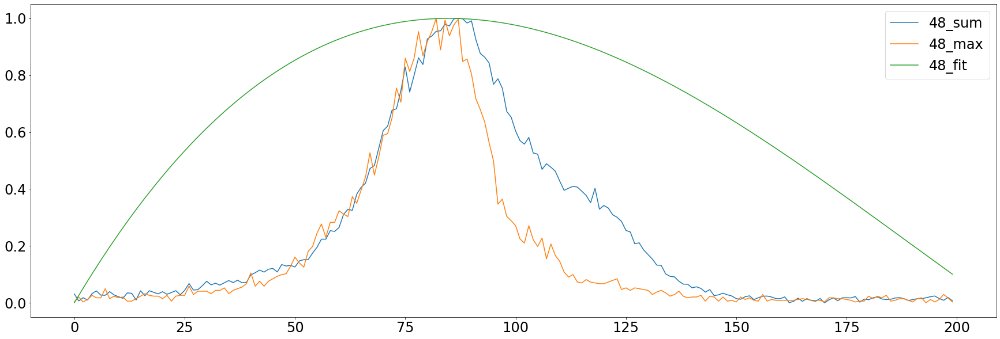

sub psf (32, 576)


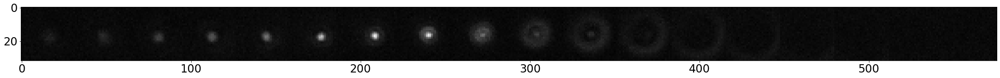

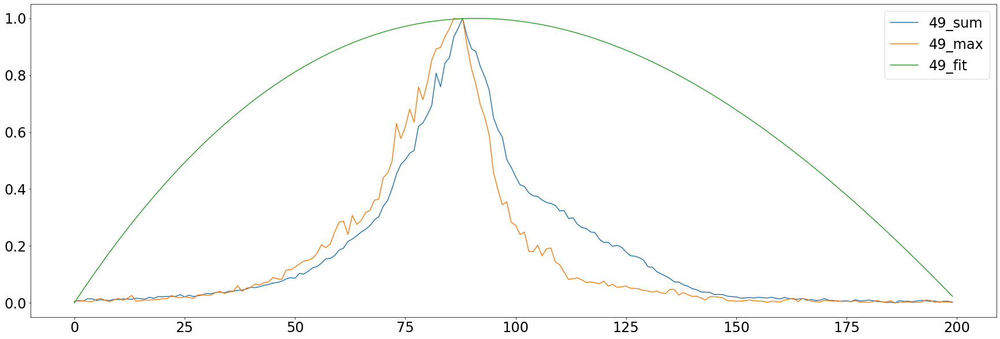

sub psf (32, 576)


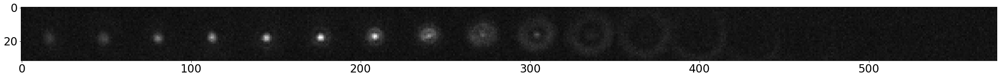

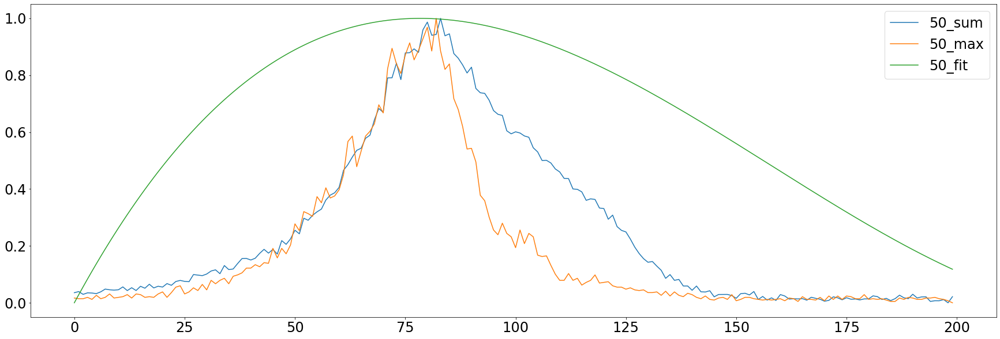

sub psf (32, 576)


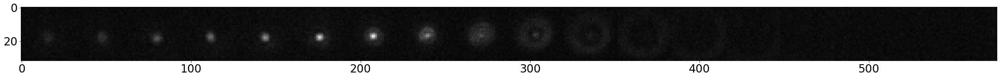

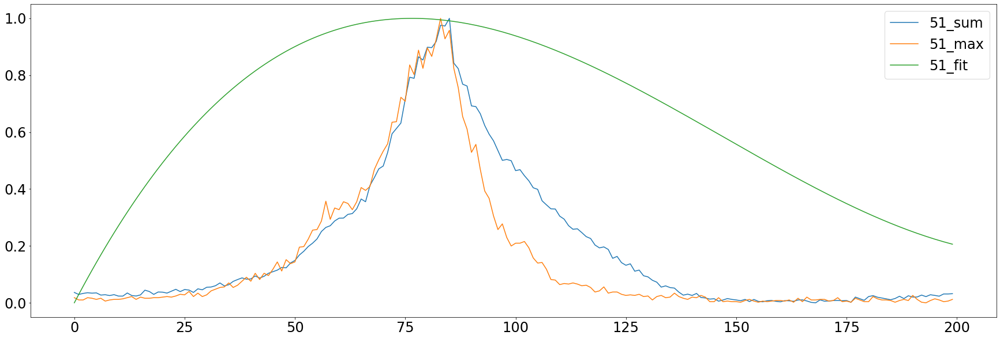

sub psf (32, 576)


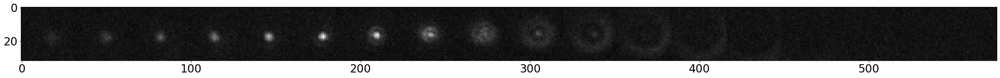

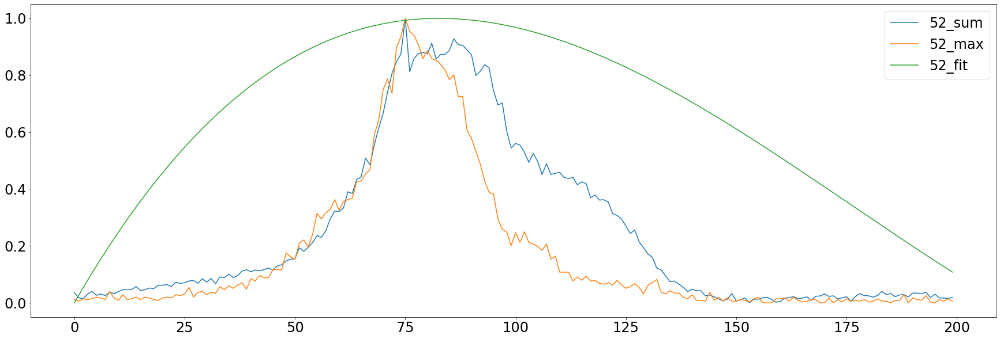

sub psf (32, 576)


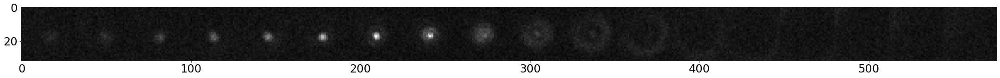

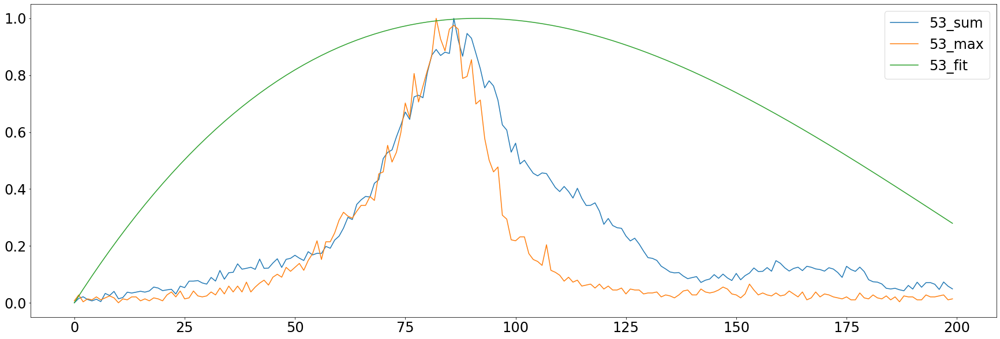

sub psf (32, 576)


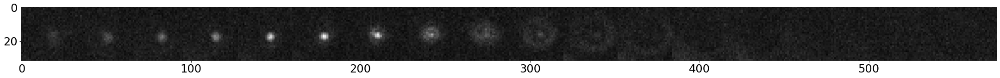

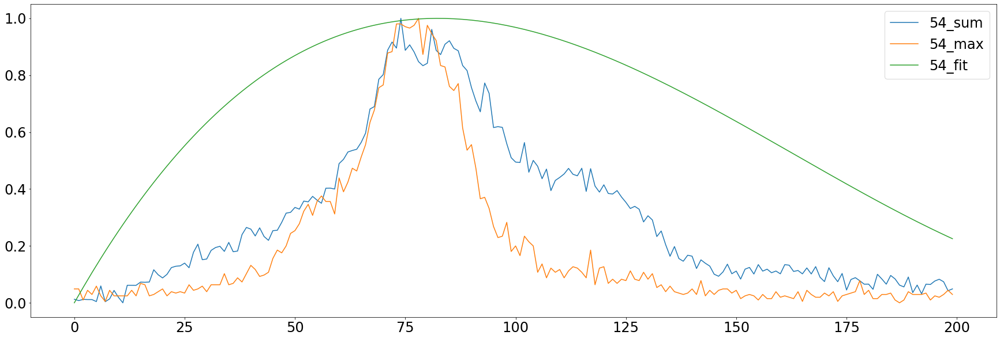

sub psf (32, 576)


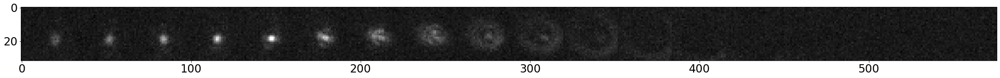

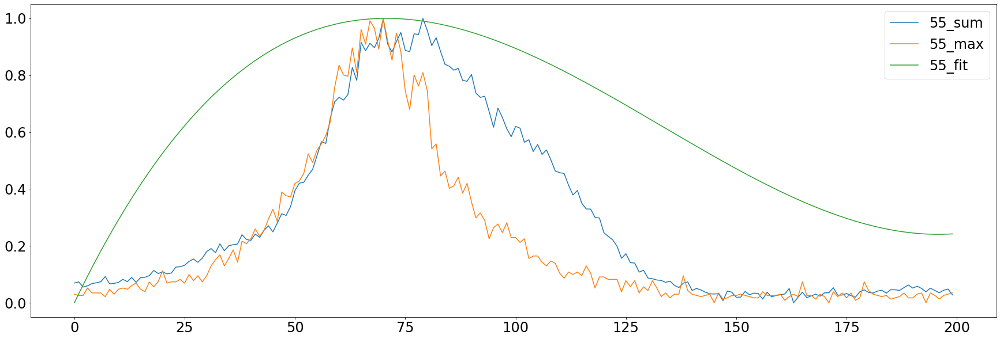

sub psf (32, 576)


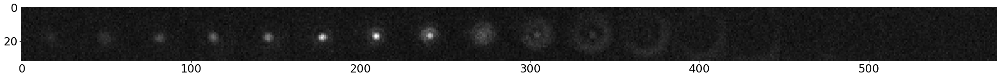

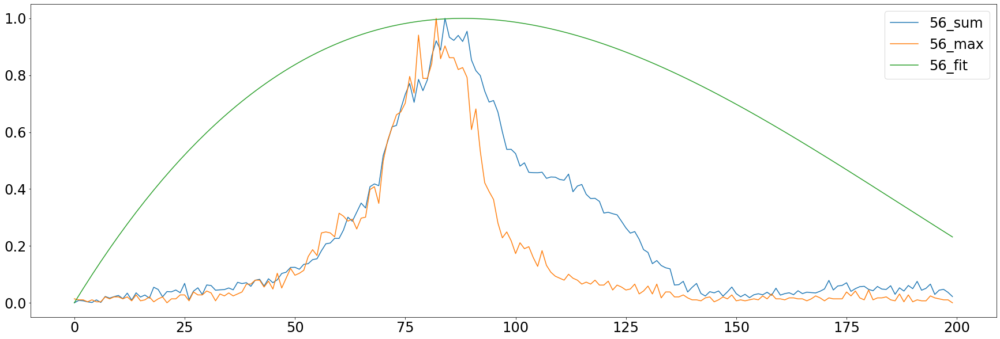

sub psf (32, 576)


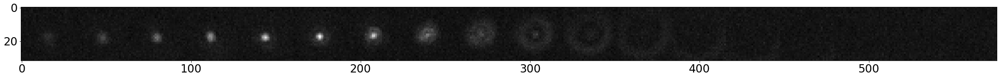

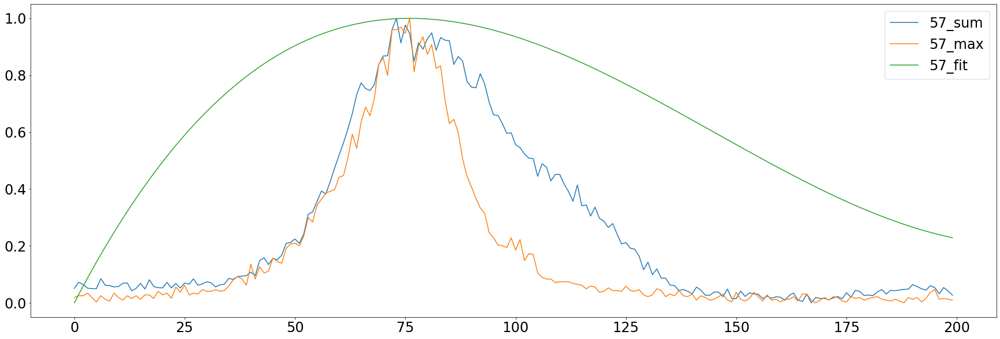

sub psf (32, 576)


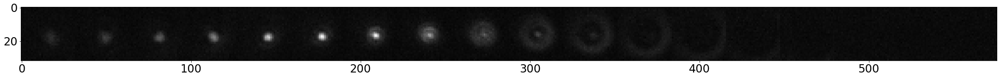

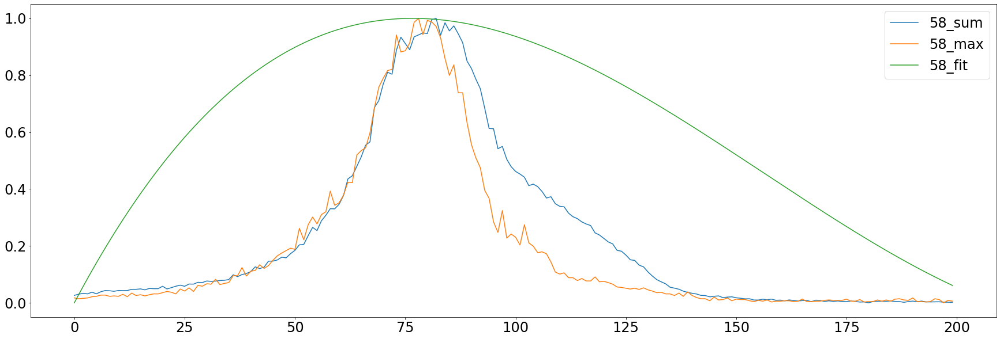

sub psf (32, 576)


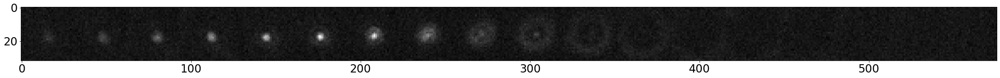

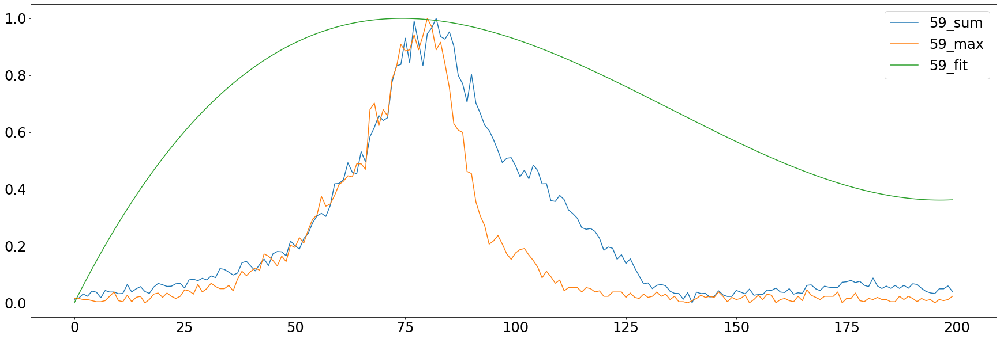

sub psf (32, 576)


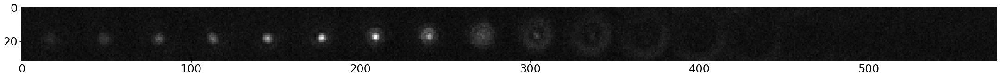

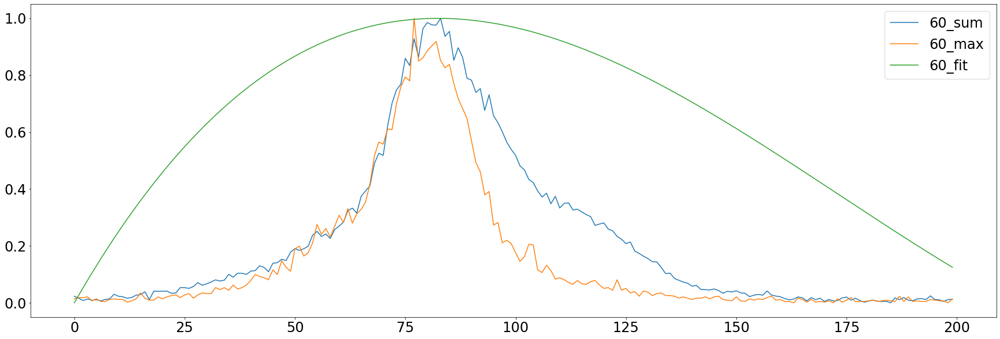

sub psf (32, 576)


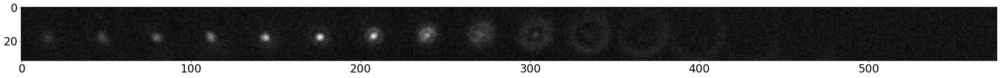

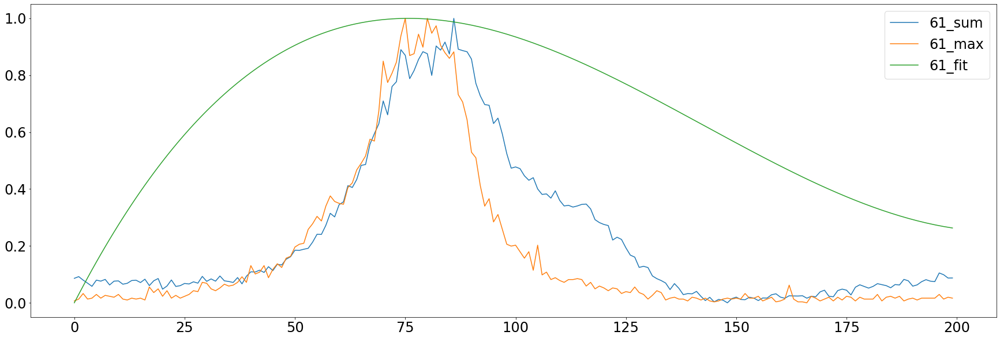

sub psf (32, 576)


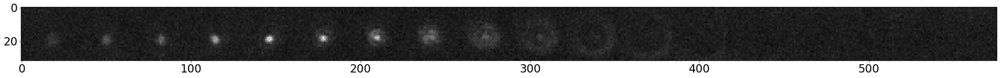

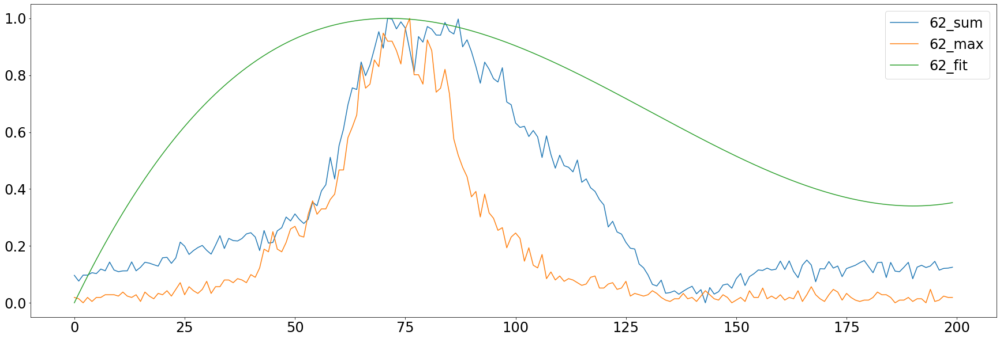

sub psf (32, 576)


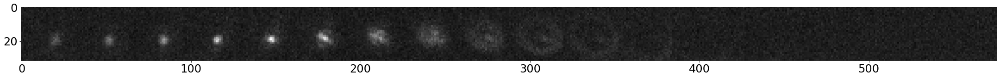

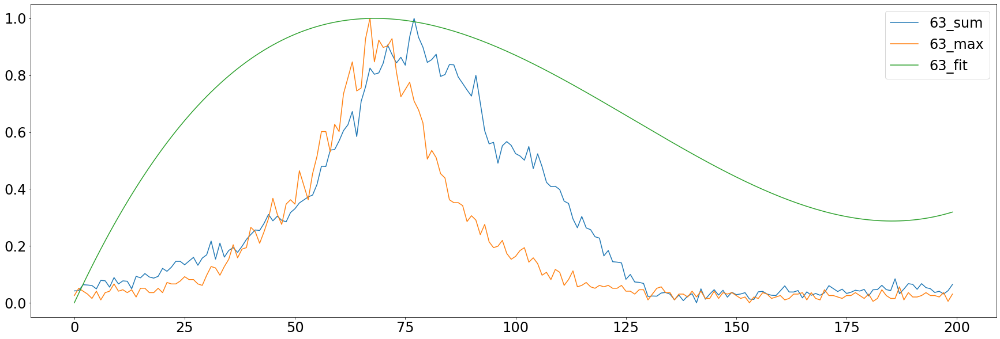

sub psf (32, 576)


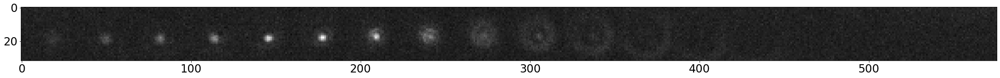

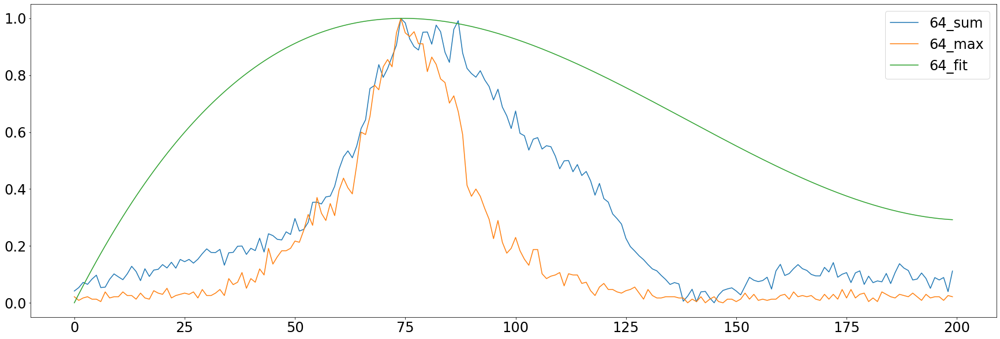

sub psf (32, 576)


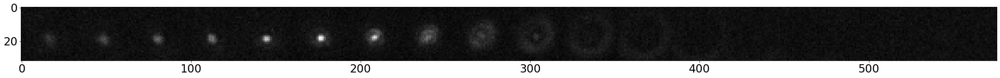

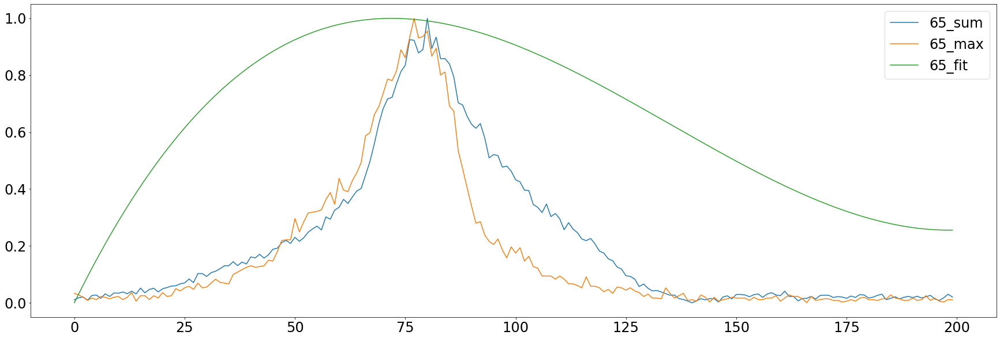

sub psf (32, 576)


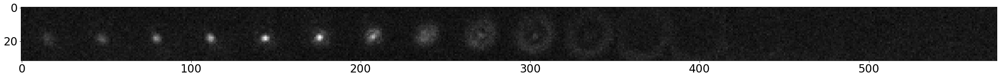

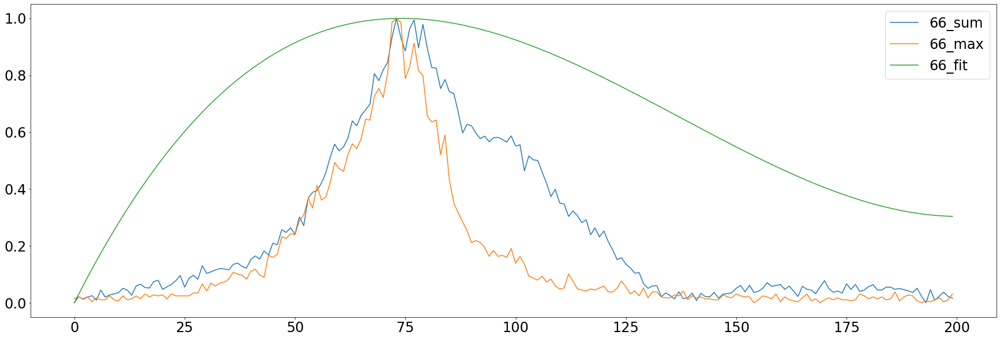

sub psf (32, 576)


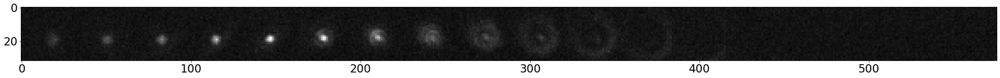

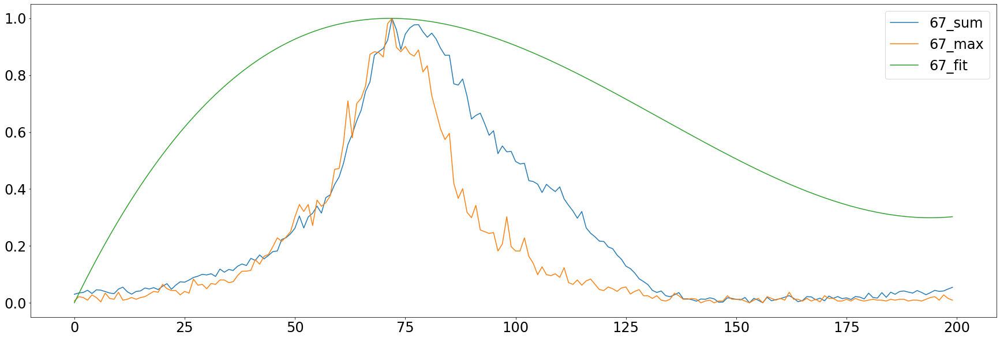

sub psf (32, 576)


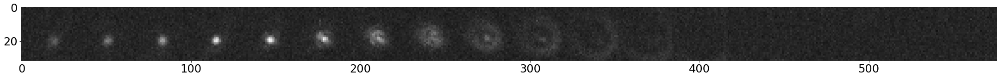

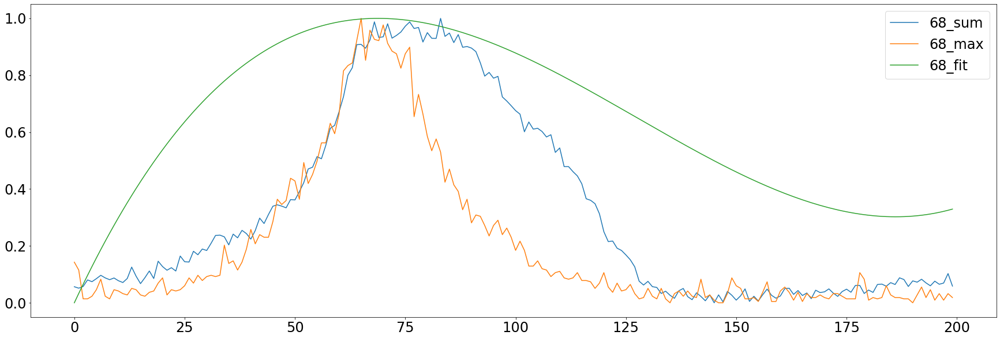

sub psf (32, 576)


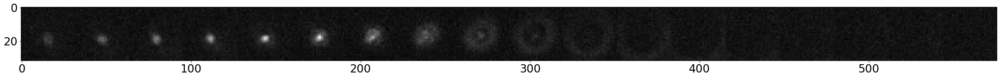

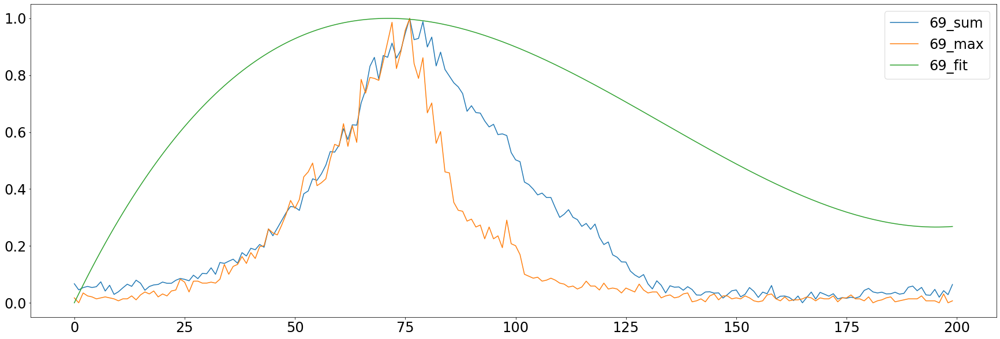

sub psf (32, 576)


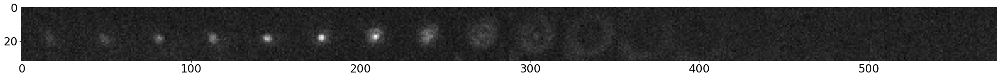

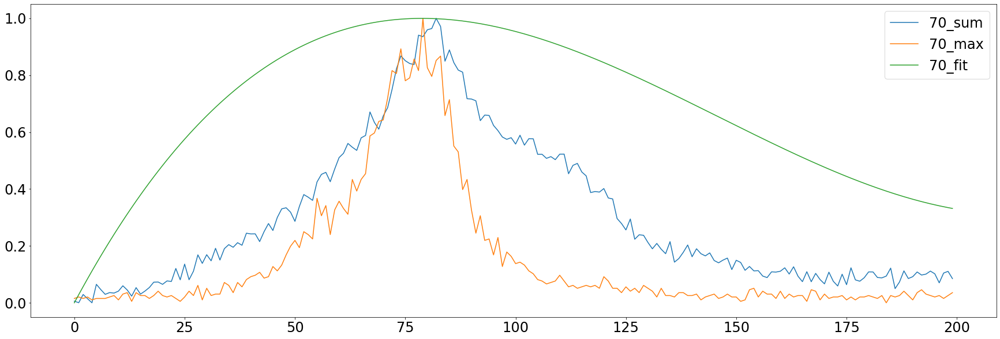

sub psf (32, 576)


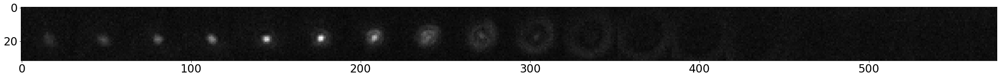

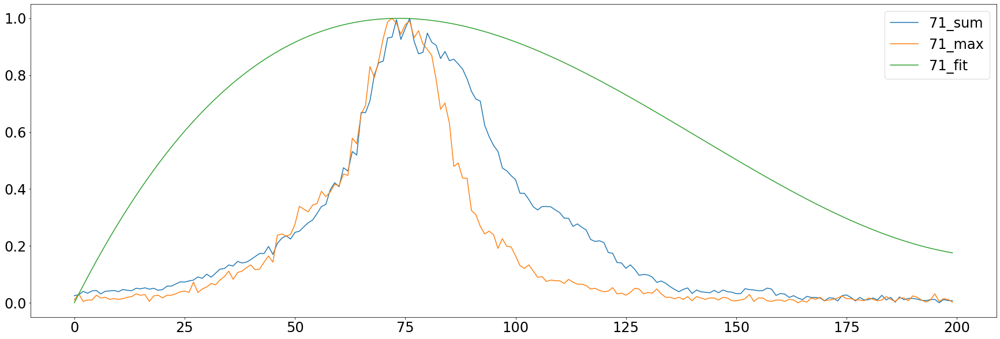

sub psf (32, 576)


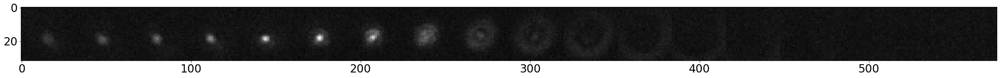

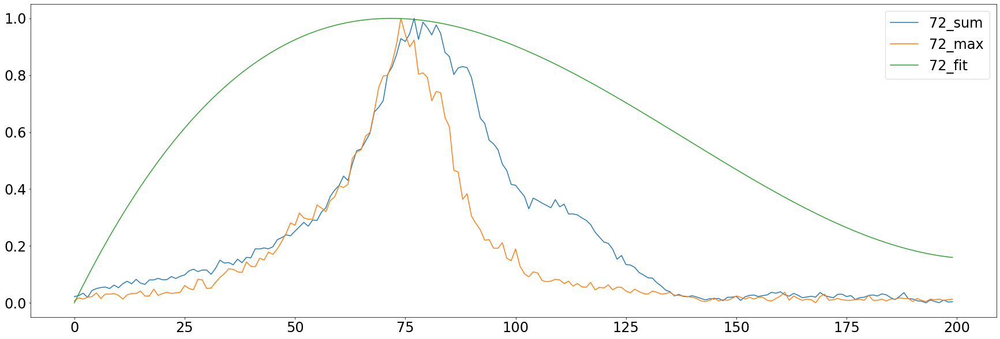

sub psf (32, 576)


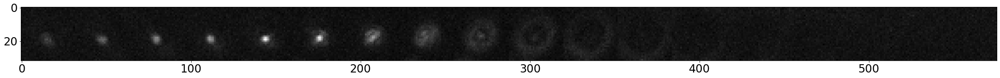

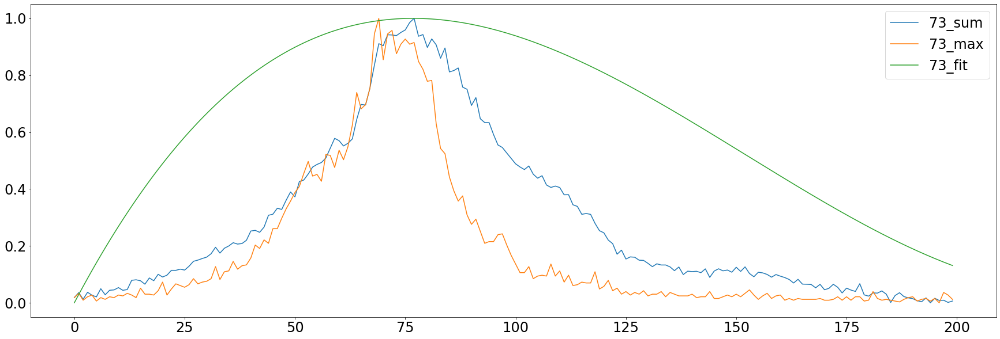

sub psf (32, 576)


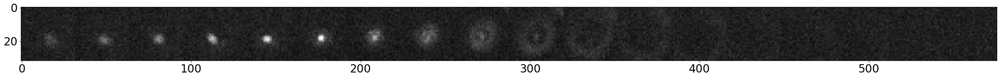

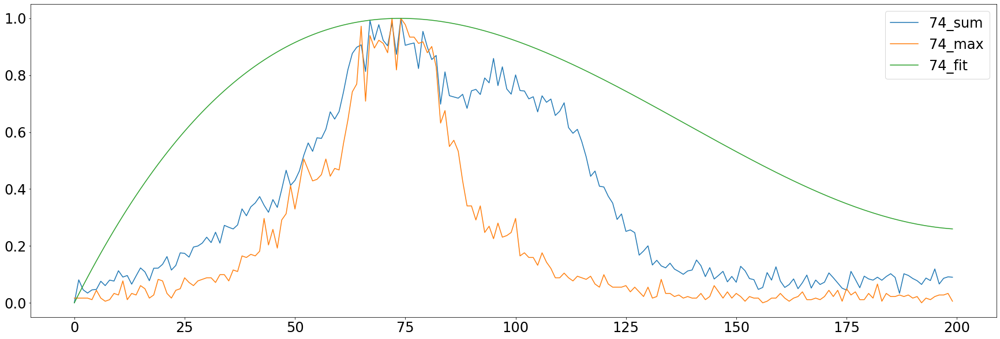

sub psf (32, 576)


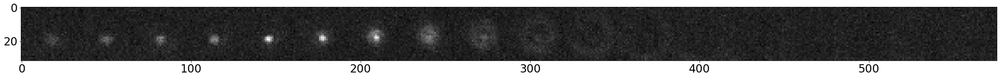

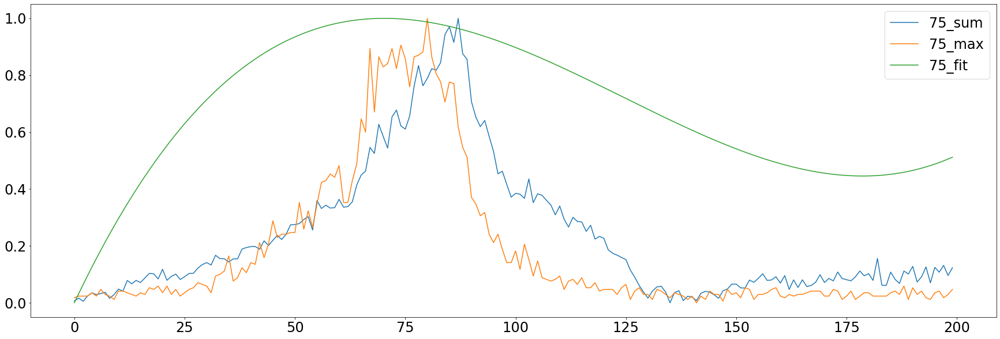

sub psf (32, 576)


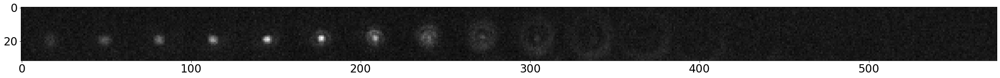

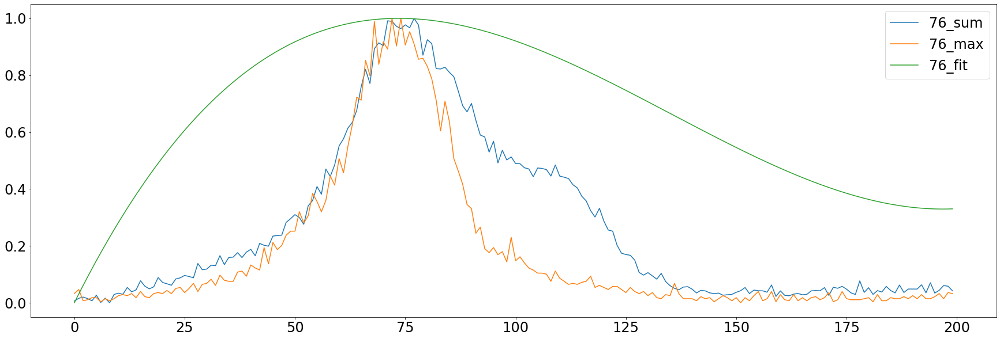

sub psf (32, 576)


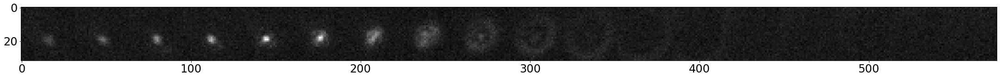

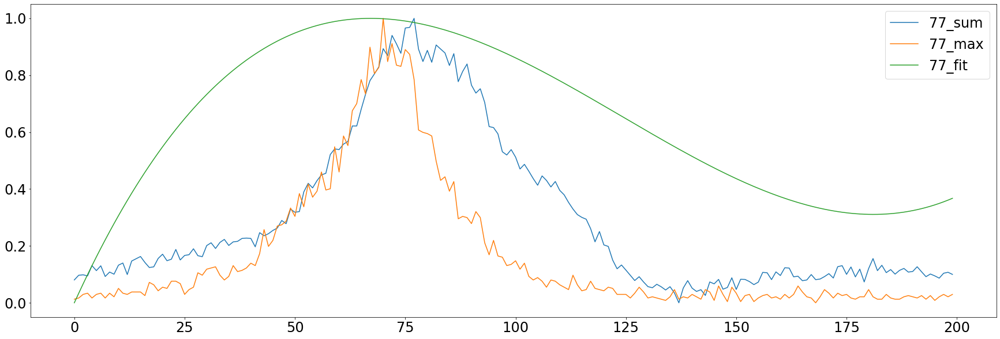

sub psf (32, 576)


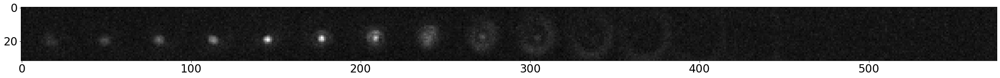

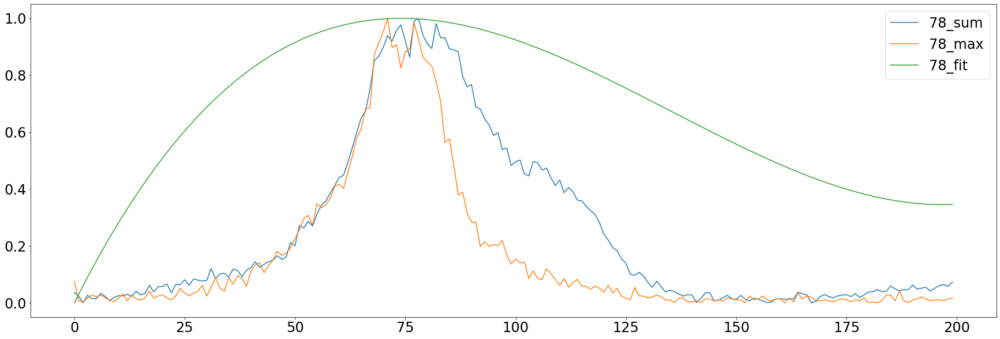

sub psf (32, 576)


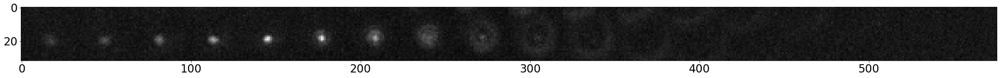

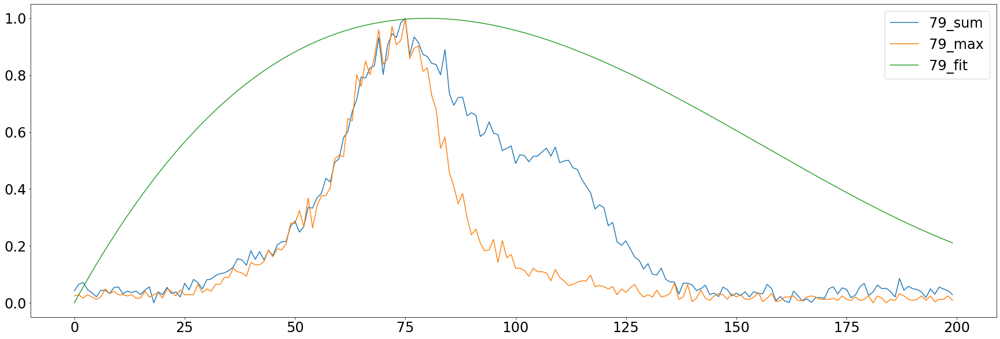

sub psf (32, 576)


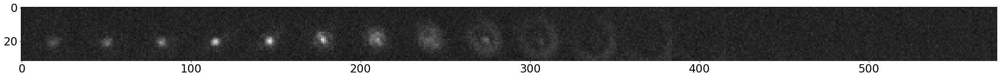

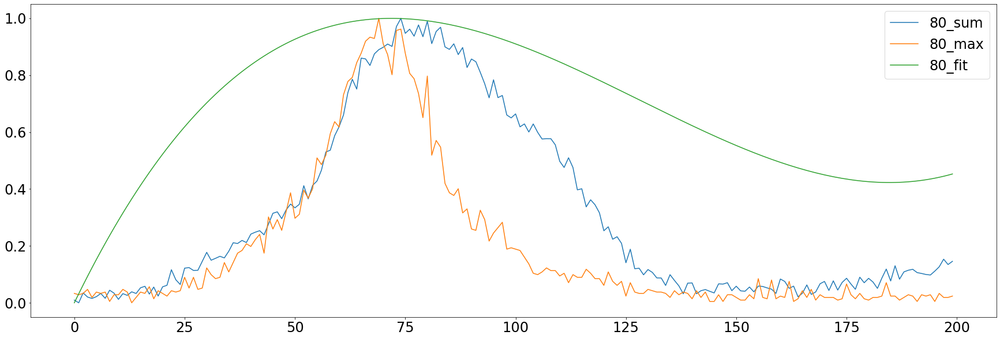

sub psf (32, 576)


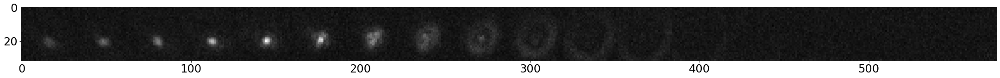

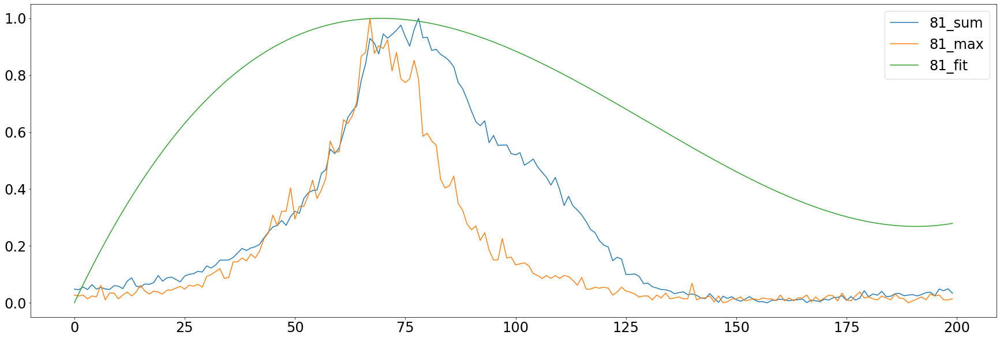

sub psf (32, 576)


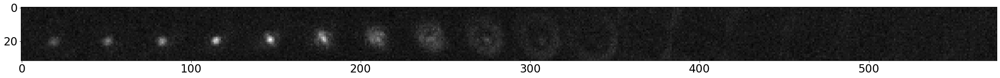

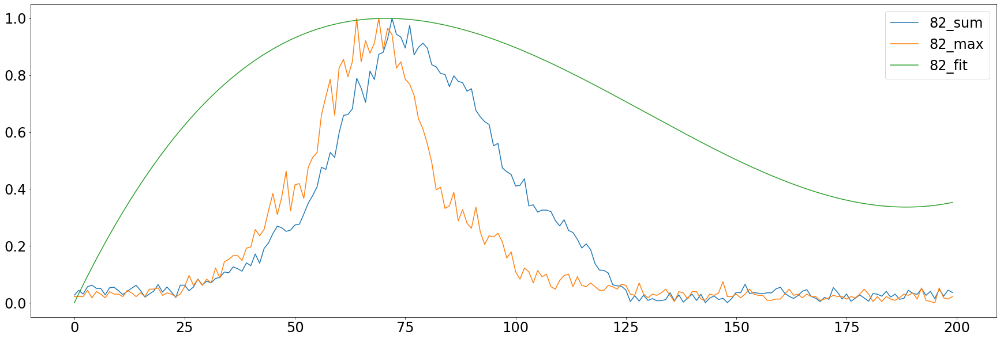

sub psf (32, 576)


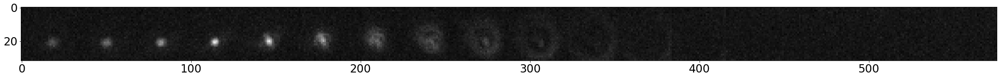

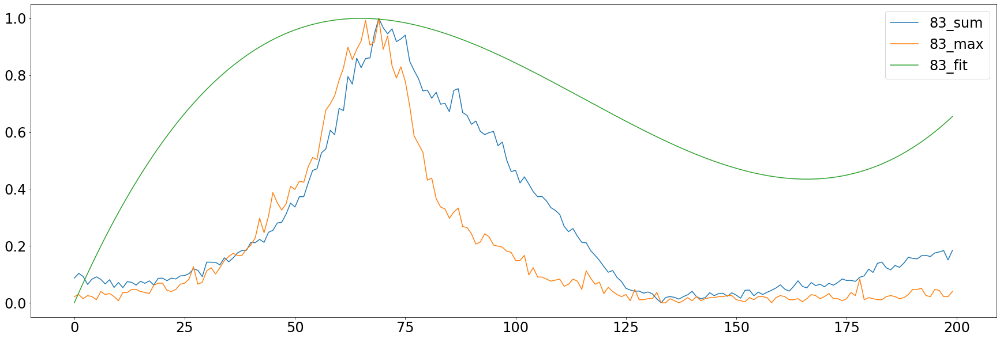

sub psf (32, 576)


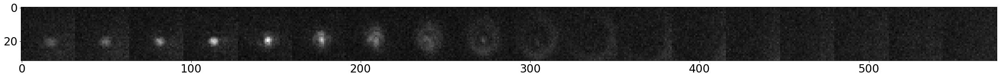

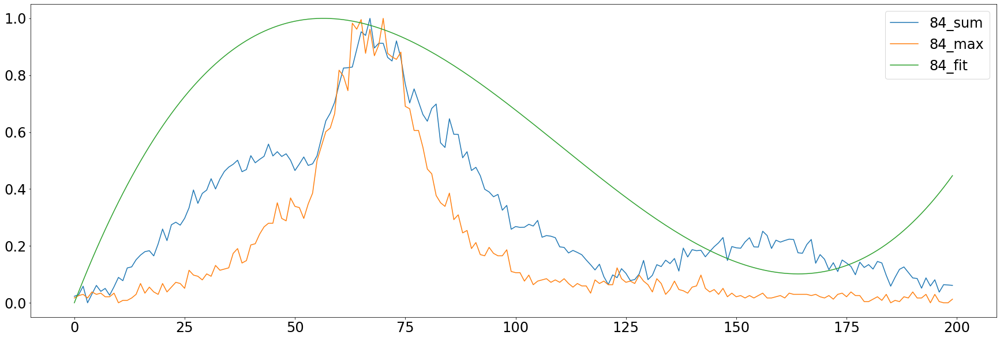

sub psf (32, 576)


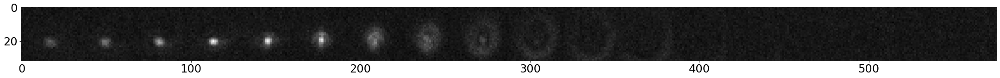

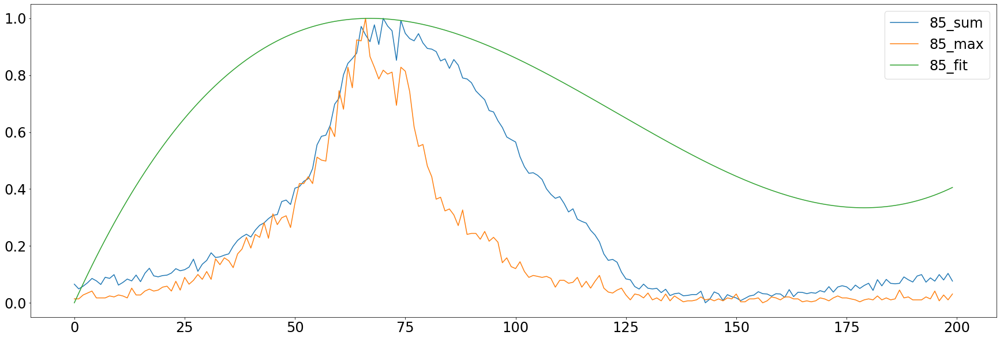

sub psf (32, 576)


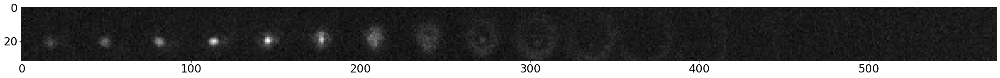

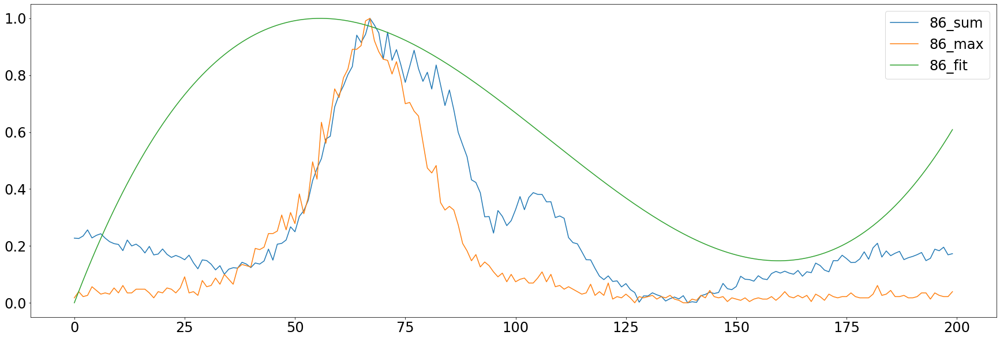

In [523]:
from scipy.interpolate import UnivariateSpline


plt.rcParams['figure.figsize'] = [30, 10] 


def fit_cubic_spline(axial_max, s=0.05):
    x = np.arange(0, len(axial_max))

    cs = UnivariateSpline(x, axial_max, k=3, s=s)
    return norm_zero_one(cs(x))

x = None
axial_maxes = dict()

peaks = []
for i in range(ds.csv_data.shape[0]):
    psf = ds.debug_emitter(i, 1e10)[0]
#     psf = butter_psf(psf)
#     psf = remove_bg(psf)
#     mask_psf(psf)
    psf = norm_zero_one(psf)
    cubic_fit = fit_cubic_spline(psf.mean(axis=(1,2)), i)
#     cubic_fit = norm_zero_one(cubic_fit)
    axial_maxes[i] = cubic_fit
    peaks.append(np.argmax(cubic_fit))
    show_psf_axial(psf)
    x = np.array(list(range(psf.shape[0])))
    plt.plot(x, norm_zero_one(np.power(psf, 2).sum(axis=(1,2))), label=str(i)+'_sum')
    plt.plot(x, norm_zero_one(psf.max(axis=(1,2))), label=str(i)+'_max')

    plt.plot(cubic_fit, label=str(i)+'_fit')
    plt.legend()
    plt.show()


# peaks = np.array(peaks)
# for i, axial_max in axial_maxes.items():
#     plt.plot(axial_max, label=str(i))
#     plt.legend()
#     plt.show()



In [453]:
mean_peak = np.mean(peaks)
emitter_idx = np.argmin(abs(peaks-mean_peak))
print(f'Centering on emitter {emitter_idx}')

Centering on emitter 13


In [347]:
# axial_maxes = {k:v for k, v in axial_maxes.items() if k < 2}
# axial_maxes[1] = np.roll(axial_maxes[0].copy(), 20)
# axial_maxes[2] = np.roll(axial_maxes[0].copy(), 40)

0.0 200.0
87


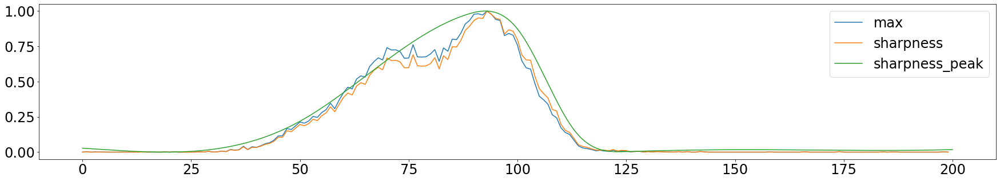

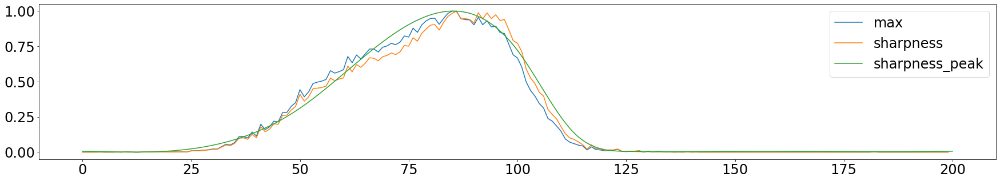

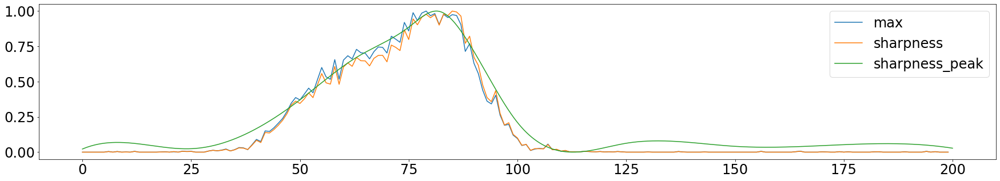

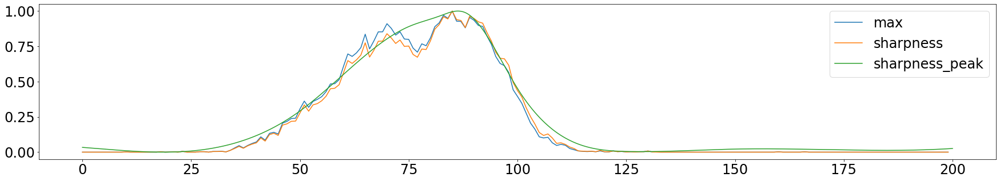

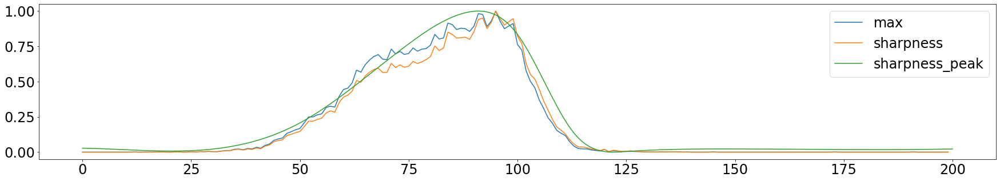

...

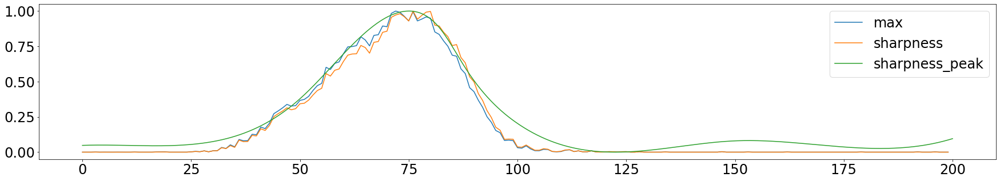

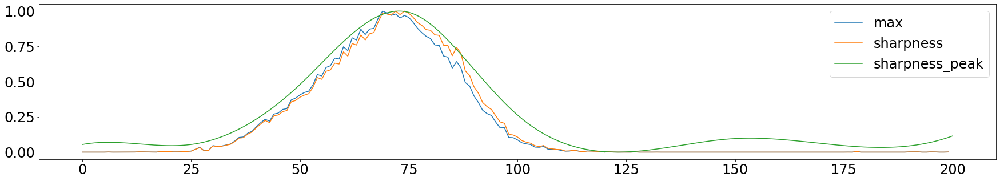

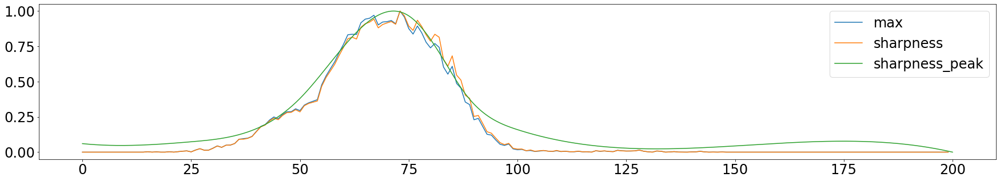

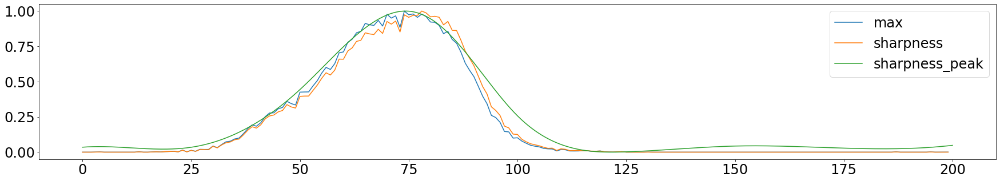

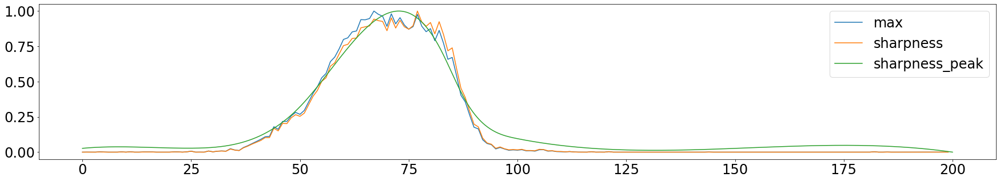

In [625]:
def find_lag(x, y):
    n = len(y)
    sr = 1
    corr = signal.correlate(x, y, mode='same') / np.sqrt(signal.correlate(x, y, mode='same')[int(n/2)] * signal.correlate(y, y, mode='same')[int(n/2)])

    delay_arr = np.linspace(-0.5*n/sr, 0.5*n/sr, n)
    delay = delay_arr[np.argmax(corr)]
    
    print(np.argmax(corr))
    return delay


def get_img_gradient(img):
    gy, gx = np.gradient(img)
    gnorm = np.sqrt(gx**2 + gy**2)
    sharpness = np.average(gnorm)
    return sharpness

psfs = [ds.debug_emitter(0, 1e10)[0]]
x = np.arange(0, psfs[0].shape[0])
sub_x = np.linspace(0, psfs[0].shape[0], 1000, endpoint=True)
print(sub_x.min(), sub_x.max())

def fit_cubic_spline(axial_max, s=0.05):
    cs = UnivariateSpline(x, axial_max, k=3, s=s)
    return norm_zero_one(cs(sub_x))

def get_sharpness(psf):
    return norm_zero_one(np.array([get_img_gradient(img) for img in psf]))
    
def get_peak_sharpness(psf):
    psf = butter_psf(psf)
    sharpness = get_sharpness(psf)
    cubic_sharpness = fit_cubic_spline(sharpness, s=0.2)
    sharpness_peak = sub_x[np.argmax(cubic_sharpness)]
    plt.plot(x, norm_zero_one(psf.max(axis=(1,2))), label='max')
    plt.plot(x, norm_zero_one(sharpness), label='sharpness')
    plt.plot(sub_x, norm_zero_one(cubic_sharpness), label='sharpness_peak')
    plt.legend()
    plt.show()
    return sharpness_peak


new_maxes = {}
new_maxes[emitter_idx] = axial_maxes[emitter_idx]

z_coords = []
from scipy import signal

x_diff = x[1]-x[0]
# plt.plot(x, axial_maxes[emitter_idx], label=str(emitter_idx))


print(len(ds.csv_data))
for i in range(0, len(ds.csv_data)):
        
    psf = ds.debug_emitter(i, 1e10)[0]
    lag = get_peak_sharpness(psf)
    
#     lag = find_lag(axial_maxes[emitter_idx], axial_maxes[i]) * x_diff
#     print(f'{i} -> {lag}')
    z_coords.append(lag)
#     plt.plot(x + (lag), axial_maxes[i], label=str(i))
# plt.legend()
# plt.show()
#     shift = x[np.argmax(correl)]
#     new_maxes[i] = np.roll(axial_maxes[i], int(shift))
#     print(f'{i} -> {shift}')
#     z_coords.append(shift)

        
plt.rcParams['figure.figsize'] = [30, 5] 

# for k, v in axial_maxes.items():
#     plt.plot(v, label=k)
# plt.xlabel('Frame in Z')
# plt.ylabel('Normalised peak intensity')
# plt.show()

# for k, v in new_maxes.items():
#     plt.plot(v, label=k)
# plt.xlabel('Frame in Z')
# plt.ylabel('Normalised peak intensity')
# plt.show()



(87, 1) (87, 2)


/home/miguel/Projects/uni/venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


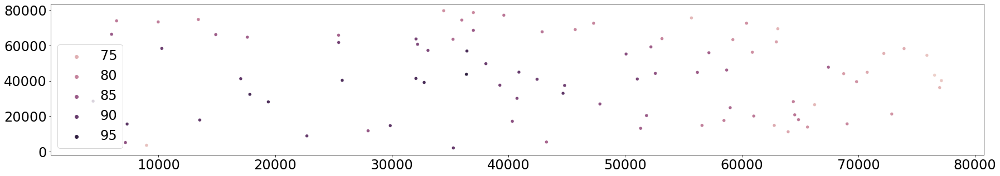

In [626]:
# z_coords = {i: np.argmax(cubic_fit) for i, cubic_fit in axial_maxes.items()}
# z_coords = np.array([x[1] for x in sorted(z_coords.items(), key=lambda x: x[0])])[:, np.newaxis] * ds.voxel_sizes[0]
import seaborn as sns
z_coords_arr = np.array(z_coords)[:, np.newaxis]
print(z_coords_arr.shape, ds.csv_data[['x [nm]', 'y [nm]']].to_numpy().shape)
coords = np.concatenate((ds.csv_data[['x [nm]', 'y [nm]']].to_numpy(), z_coords_arr), axis=1)

sns.scatterplot(coords[:, 0], coords[:, 1], hue=coords[:, 2])
plt.show()

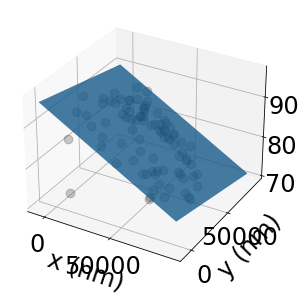

/home/miguel/Projects/uni/venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


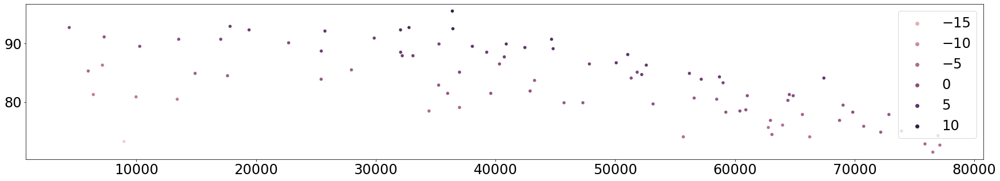

/home/miguel/Projects/uni/venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


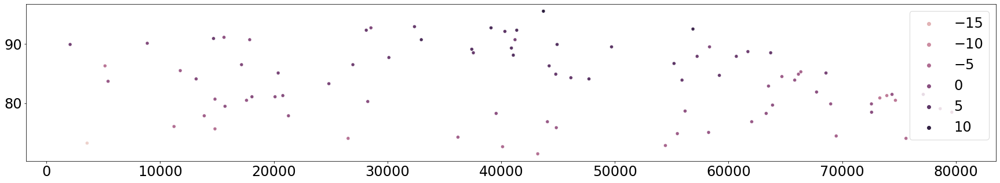

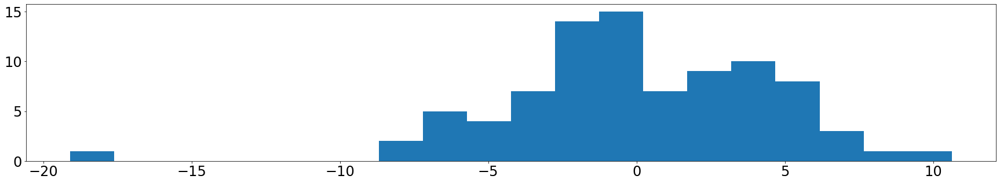

3.403960680768853


In [627]:
from skspatial.objects import Plane
from skspatial.objects import Points
from skspatial.plotting import plot_3d

def fit_plane(coords):
    points = Points(coords)
    plane = Plane.best_fit(points)
    plot_3d(
        points.plotter(c='k', s=75, alpha=0.2, depthshade=False),
        plane.plotter(alpha=0.8, lims_x=(-50000, 50000), lims_y=(-50000, 50000)),
    )
    plt.xlabel('x (nm)')
    plt.ylabel('y (nm)')
    plt.show()
    dists = [plane.distance_point_signed(p) for p in points]
    sns.scatterplot(coords[:, 0], coords[:, 2], hue=dists)
    plt.show()

    sns.scatterplot(coords[:, 1], coords[:, 2], hue=dists)
    plt.show()
    plt.hist(dists, bins=20)
    plt.show()
    print(np.mean(np.abs(dists)))
fit_plane(coords)